In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import os

In [2]:
cellids = pd.read_csv('../data/220309_cell_type_classification.csv', index_col=[0])
cellids

,centroid_x,centroid_y,centroid_z,cell_segid,cell_type,cell_subtype
1,41760,60256,1702,648518346349538237,pyramidal,pyramidal cell
2,98128,39856,218,648518346349536816,pyramidal,pyramidal cell
3,51248,50608,86,648518346349539797,pyramidal,pyramidal cell
5,115392,47136,617,648518346349536744,pyramidal,pyramidal cell
6,104928,72496,1448,648518346349536851,pyramidal,pyramidal cell
...,...,...,...,...,...,...
68,107312,43552,2160,648518346349375478,vasculature,endothelial
69,104752,40768,878,648518346349061101,vasculature,endothelial
70,104464,40784,1867,648518346349375478,vasculature,endothelial
71,97377,38012,1145,648518346349375478,vasculature,endothelial


In [3]:
cellids[cellids['cell_segid'] == 648518346349540057]

,centroid_x,centroid_y,centroid_z,cell_segid,cell_type,cell_subtype
893,103712,44304,874,648518346349540057,pyramidal,pyramidal cell


In [4]:
nucids = pd.read_csv('../data/230106_soma_valence_v185.csv', index_col=[0])
nucids

,id,cell_type,pt_position,pt_root_id,soma_x_nm,soma_y_nm,soma_z_nm,nuc_id
0,17,e,[103860 44385 891],648518346349540057,415440,177540,35640,4809
1,453,e,[84054 50604 1424],648518346349538466,336216,202416,56960,6097
2,35,e,[103728 54333 304],648518346349538711,414912,217332,12160,6582
3,74,e,[51543 57568 155],648518346349538715,206172,230272,6200,7498
4,231,e,[77197 61773 428],648518346349537038,308788,247092,17120,8610
...,...,...,...,...,...,...,...,...
451,298,e,[116314 58234 933],648518346349537961,465256,232936,37320,7570
452,444,e,[70253 54531 1752],648518346349538336,281012,218124,70080,6877
453,69,e,[75256 56402 571],648518346349537509,301024,225608,22840,7525
454,116,e,[77180 55980 185],648518346349537641,308720,223920,7400,6557


In [5]:
nucids.cell_type.value_counts()

e            362
g             59
i             34
uncertain      1
Name: cell_type, dtype: int64

In [6]:
nucid_table = nucids.drop(columns=['id','cell_type'])
nucid_table.rename(columns={'pt_root_id':'cell_segid'}, inplace=True)
nucid_table

,pt_position,cell_segid,soma_x_nm,soma_y_nm,soma_z_nm,nuc_id
0,[103860 44385 891],648518346349540057,415440,177540,35640,4809
1,[84054 50604 1424],648518346349538466,336216,202416,56960,6097
2,[103728 54333 304],648518346349538711,414912,217332,12160,6582
3,[51543 57568 155],648518346349538715,206172,230272,6200,7498
4,[77197 61773 428],648518346349537038,308788,247092,17120,8610
...,...,...,...,...,...,...
451,[116314 58234 933],648518346349537961,465256,232936,37320,7570
452,[70253 54531 1752],648518346349538336,281012,218124,70080,6877
453,[75256 56402 571],648518346349537509,301024,225608,22840,7525
454,[77180 55980 185],648518346349537641,308720,223920,7400,6557


In [7]:
cellids.cell_type.value_counts()

pyramidal      416
glia            97
vasculature     72
inhibitory      34
Name: cell_type, dtype: int64

In [8]:
cellids.cell_subtype.value_counts()

pyramidal cell                                                     416
endothelial                                                         71
astrocyte                                                           44
microglia                                                           28
unknown_type                                                        18
OPC                                                                 14
bipolar                                                             12
basket                                                               4
oligodendrocyte                                                      2
chandelier                                                           2
microglia (perivascular)                                             2
pericyte                                                             1
unknown (at edge of volume)                                          1
martinotti                                                           1
neurog

In [9]:
astrocytes = cellids[cellids['cell_subtype'] == 'astrocyte']
len(astrocytes)

44

In [10]:
cellids_withnucid_outer = pd.merge(cellids, nucid_table, on='cell_segid', how='outer')
cellids_withnucid_outer

,centroid_x,centroid_y,centroid_z,cell_segid,cell_type,cell_subtype,pt_position,soma_x_nm,soma_y_nm,soma_z_nm,nuc_id
0,41760.0,60256.0,1702.0,648518346349538237,pyramidal,pyramidal cell,[42065 60352 1724],168260.0,241408.0,68960.0,7669.0
1,98128.0,39856.0,218.0,648518346349536816,pyramidal,pyramidal cell,[98028 39919 232],392112.0,159676.0,9280.0,1318.0
2,51248.0,50608.0,86.0,648518346349539797,pyramidal,pyramidal cell,[51691 50574 126],206764.0,202296.0,5040.0,5441.0
3,115392.0,47136.0,617.0,648518346349536744,pyramidal,pyramidal cell,NaN,NaN,NaN,NaN,NaN
4,104928.0,72496.0,1448.0,648518346349536851,pyramidal,pyramidal cell,[104870 72471 1446],419480.0,289884.0,57840.0,11847.0
...,...,...,...,...,...,...,...,...,...,...,...
637,NaN,NaN,NaN,648518346346301363,NaN,NaN,[89429 53223 2028],357716.0,212892.0,81120.0,6911.0
638,NaN,NaN,NaN,648518346344147845,NaN,NaN,[104541 69251 1038],418164.0,277004.0,41520.0,11077.0
639,NaN,NaN,NaN,648518346342926256,NaN,NaN,[106805 66273 1038],427220.0,265092.0,41520.0,9715.0
640,NaN,NaN,NaN,648518346348198632,NaN,NaN,[114702 49688 2068],458808.0,198752.0,82720.0,6151.0


In [11]:
cellids_withnucid_inner = pd.merge(cellids, nucid_table, on='cell_segid', how='inner')
cellids_withnucid_inner

,centroid_x,centroid_y,centroid_z,cell_segid,cell_type,cell_subtype,pt_position,soma_x_nm,soma_y_nm,soma_z_nm,nuc_id
0,41760,60256,1702,648518346349538237,pyramidal,pyramidal cell,[42065 60352 1724],168260,241408,68960,7669
1,98128,39856,218,648518346349536816,pyramidal,pyramidal cell,[98028 39919 232],392112,159676,9280,1318
2,51248,50608,86,648518346349539797,pyramidal,pyramidal cell,[51691 50574 126],206764,202296,5040,5441
3,104928,72496,1448,648518346349536851,pyramidal,pyramidal cell,[104870 72471 1446],419480,289884,57840,11847
4,58128,35616,2059,648518346349522862,pyramidal,pyramidal cell,[58210 35590 2059],232840,142360,82360,123
...,...,...,...,...,...,...,...,...,...,...,...
480,59680,69104,2113,648518346349530569,glia,astrocyte,[59596 69165 2132],238384,276660,85280,11782
481,72704,55888,576,648518346349536717,glia,microglia (merged with nucleus of astrocyte 64...,[72779 55950 577],291116,223800,23080,6554
482,72704,55888,576,648518346349536717,glia,microglia (merged with nucleus of astrocyte 64...,[72565 54543 492],290260,218172,19680,6553
483,100576,42592,739,648518346349538793,glia,OPC,[100487 42666 727],401948,170664,29080,3670


In [12]:
astrocytes_withnucid = cellids_withnucid_inner[cellids_withnucid_inner['cell_subtype'] == 'astrocyte']
astrocytes_withnucid

,centroid_x,centroid_y,centroid_z,cell_segid,cell_type,cell_subtype,pt_position,soma_x_nm,soma_y_nm,soma_z_nm,nuc_id
399,79328,67360,445,648518346349525544,glia,astrocyte,[79431 67616 403],317724,270464,16120,9689
456,101120,49760,60,648518346349386860,glia,astrocyte,[101058 49862 53],404232,199448,2120,5709
458,110816,60768,234,648518346342795947,glia,astrocyte,[110817 60682 237],443268,242728,9480,8656
460,82192,40208,138,648518346349524139,glia,astrocyte,[82362 40049 126],329448,160196,5040,3554
462,51200,62384,363,648518346349528249,glia,astrocyte,[51194 62310 354],204776,249240,14160,8583
463,56976,56032,785,648518346349528250,glia,astrocyte,[56945 55996 815],227780,223984,32600,6542
465,87104,59520,93,648518346349498574,glia,astrocyte,[87040 59386 98],348160,237544,3920,7533
466,75152,54848,2064,648518346349525715,glia,astrocyte,[75134 54933 2078],300536,219732,83120,6881
467,75152,54848,2064,648518346349525715,glia,astrocyte,[78085 61768 1260],312340,247072,50400,9080
469,53136,62176,320,648518346349536487,glia,astrocyte,[53383 62029 354],213532,248116,14160,8589


In [13]:
len(astrocytes_withnucid)

16

In [14]:
print(astrocytes_withnucid.cell_segid.to_list())

[648518346349525544, 648518346349386860, 648518346342795947, 648518346349524139, 648518346349528249, 648518346349528250, 648518346349498574, 648518346349525715, 648518346349525715, 648518346349536487, 648518346349527316, 648518346349527319, 648518346349517141, 648518346349525862, 648518346349521344, 648518346349530569]


In [15]:
print(astrocytes_withnucid.nuc_id.to_list())

[9689, 5709, 8656, 3554, 8583, 6542, 7533, 6881, 9080, 8589, 13913, 4308, 4766, 8604, 9655, 11782]


In [16]:
vasc = cellids[cellids['cell_type'] == 'vasculature']
vasc

,centroid_x,centroid_y,centroid_z,cell_segid,cell_type,cell_subtype
0,113904,67296,24,648518346342804483,vasculature,endothelial
1,44512,71312,94,648518346341422370,vasculature,endothelial
2,76944,58784,1987,648518346349526102,vasculature,pericyte
3,104256,40800,1968,648518346349375478,vasculature,endothelial
4,45168,69328,105,648518346343497543,vasculature,endothelial
...,...,...,...,...,...,...
68,107312,43552,2160,648518346349375478,vasculature,endothelial
69,104752,40768,878,648518346349061101,vasculature,endothelial
70,104464,40784,1867,648518346349375478,vasculature,endothelial
71,97377,38012,1145,648518346349375478,vasculature,endothelial


In [17]:
vasc.cell_segid.value_counts()

648518346349526102    49
648518346349375478     4
648518346348121670     4
648518346348189552     2
648518346344505300     1
648518346344072053     1
648518346341763956     1
648518346343459827     1
648518346349061101     1
648518346342804483     1
648518346345118988     1
648518346344456391     1
648518346343497543     1
648518346342796989     1
648518346341422370     1
648518346342104735     1
648518346344328018     1
Name: cell_segid, dtype: int64

In [18]:
vasc.cell_segid.unique()

array([648518346342804483, 648518346341422370, 648518346349526102,
       648518346349375478, 648518346343497543, 648518346348189552,
       648518346344072053, 648518346348121670, 648518346344328018,
       648518346344456391, 648518346344505300, 648518346341763956,
       648518346345118988, 648518346342104735, 648518346343459827,
       648518346342796989, 648518346349061101], dtype=int64)

# Astroctye viewer

In [19]:
astrocytes

,centroid_x,centroid_y,centroid_z,cell_segid,cell_type,cell_subtype
0,88240,60656,256,648518346349517321,glia,astrocyte
1,72368,56912,590,648518346341392909,glia,astrocyte
4,72704,54688,506,648518346349536799,glia,astrocyte
5,74576,75520,1163,648518346349525537,glia,astrocyte
6,79328,67360,445,648518346349525544,glia,astrocyte
10,95184,37376,1808,648518346349526583,glia,astrocyte
12,83952,46640,1633,648518346349490239,glia,astrocyte
18,80272,56768,2068,648518346349524070,glia,astrocyte
20,101120,49760,60,648518346349386860,glia,astrocyte
23,73712,73056,1123,648518346349508722,glia,astrocyte


In [20]:
# astrocytes.to_csv('../data/astrocytes.csv')

In [21]:
astrocyte_list = astrocytes.cell_segid.sort_values().to_list()
print(astrocyte_list)

[648518346341354380, 648518346341356348, 648518346341392909, 648518346341399264, 648518346342468778, 648518346342795202, 648518346342795947, 648518346342797245, 648518346342807831, 648518346342917290, 648518346344075119, 648518346349386860, 648518346349484948, 648518346349490239, 648518346349498574, 648518346349507266, 648518346349508722, 648518346349516953, 648518346349517141, 648518346349517321, 648518346349521062, 648518346349521344, 648518346349524070, 648518346349524139, 648518346349525537, 648518346349525544, 648518346349525715, 648518346349525862, 648518346349526583, 648518346349527316, 648518346349527317, 648518346349527319, 648518346349528249, 648518346349528250, 648518346349528271, 648518346349528465, 648518346349530569, 648518346349532924, 648518346349536487, 648518346349536799, 648518346349536888, 648518346349537050, 648518346349538089, 648518346349539158]


In [22]:
len(astrocyte_list)

44

# Neuroglancer viewer for astrocyte_list (cells only)

In [23]:
indx = 0

lookup = astrocyte_list[indx]

query = cellids["cell_segid"] == lookup
querydf = cellids.loc[query]

baseURL = 'https://neuromancer-seung-import.appspot.com/'
nglink_a = '#!%7B%22layers%22:%5B%7B%22source%22:%22precomputed://gs://microns_public_datasets/pinky100_v0/son_of_alignment_v15_rechunked%22%2C%22type%22:%22image%22%2C%22blend%22:%22default%22%2C%22shaderControls%22:%7B%7D%2C%22name%22:%22EM%22%7D%2C%7B%22source%22:%22precomputed://gs://microns_public_datasets/pinky100_v185/seg%22%2C%22type%22:%22segmentation%22%2C%22selectedAlpha%22:0.51%2C%22segments%22:%5B%22'
nglink_b = '%22%5D%2C%22skeletonRendering%22:%7B%22mode2d%22:%22lines_and_points%22%2C%22mode3d%22:%22lines%22%7D%2C%22name%22:%22cell_segmentation_v185%22%7D%2C%7B%22source%22:%22precomputed://https://td.princeton.edu/sseung-archive/pinky100-clefts/mip1_d2_1175k%22%2C%22type%22:%22segmentation%22%2C%22skeletonRendering%22:%7B%22mode2d%22:%22lines_and_points%22%2C%22mode3d%22:%22lines%22%7D%2C%22name%22:%22synapses%22%7D%2C%7B%22source%22:%22precomputed://https://td.princeton.edu/sseung-archive/pinky100-mito/seg_191220%22%2C%22type%22:%22segmentation%22%2C%22skeletonRendering%22:%7B%22mode2d%22:%22lines_and_points%22%2C%22mode3d%22:%22lines%22%7D%2C%22name%22:%22mitochondria%22%7D%2C%7B%22source%22:%22precomputed://https://td.princeton.edu/sseung-archive/pinky100-nuclei/seg%22%2C%22type%22:%22segmentation%22%2C%22skeletonRendering%22:%7B%22mode2d%22:%22lines_and_points%22%2C%22mode3d%22:%22lines%22%7D%2C%22name%22:%22nuclei%22%7D%5D%2C%22navigation%22:%7B%22pose%22:%7B%22position%22:%7B%22voxelSize%22:%5B4%2C4%2C40%5D%2C%22voxelCoordinates%22:%5B'
nglink_c = '%5D%7D%7D%2C%22zoomFactor%22:383.0066650796121%7D%2C%22perspectiveOrientation%22:%5B-0.00825042650103569%2C0.06130112707614899%2C-0.0012821174459531903%2C0.9980843663215637%5D%2C%22perspectiveZoom%22:3618.7659948513424%2C%22showSlices%22:false%2C%22selectedLayer%22:%7B%22layer%22:%22cell_segmentation_v185%22%2C%22visible%22:true%7D%2C%22layout%22:%7B%22type%22:%223d%22%2C%22orthographicProjection%22:true%7D%7D'
neuroglancerURL = baseURL + nglink_a + str(lookup) + nglink_b + str(querydf.centroid_x.iloc[0]) +'%2C' + str(querydf.centroid_y.iloc[0]) + '%2C' + str(querydf.centroid_z.iloc[0]) + nglink_c 

print(neuroglancerURL)


https://neuromancer-seung-import.appspot.com/#!%7B%22layers%22:%5B%7B%22source%22:%22precomputed://gs://microns_public_datasets/pinky100_v0/son_of_alignment_v15_rechunked%22%2C%22type%22:%22image%22%2C%22blend%22:%22default%22%2C%22shaderControls%22:%7B%7D%2C%22name%22:%22EM%22%7D%2C%7B%22source%22:%22precomputed://gs://microns_public_datasets/pinky100_v185/seg%22%2C%22type%22:%22segmentation%22%2C%22selectedAlpha%22:0.51%2C%22segments%22:%5B%22648518346341354380%22%5D%2C%22skeletonRendering%22:%7B%22mode2d%22:%22lines_and_points%22%2C%22mode3d%22:%22lines%22%7D%2C%22name%22:%22cell_segmentation_v185%22%7D%2C%7B%22source%22:%22precomputed://https://td.princeton.edu/sseung-archive/pinky100-clefts/mip1_d2_1175k%22%2C%22type%22:%22segmentation%22%2C%22skeletonRendering%22:%7B%22mode2d%22:%22lines_and_points%22%2C%22mode3d%22:%22lines%22%7D%2C%22name%22:%22synapses%22%7D%2C%7B%22source%22:%22precomputed://https://td.princeton.edu/sseung-archive/pinky100-mito/seg_191220%22%2C%22type%22:%22s

# Neuroglancer viewer for astrocyte_list (cells and mitochondria)

In [24]:
# this csv file is 261 MB and too large to place on Github
# in order to run this notebook, you must first download the file and place on your local machine in the /data folder
# the csv file is available here: https://zenodo.org/record/5579388/files/211019_mitochondria_info.csv

mito = pd.read_csv("../data/211019_mitochondria_info.csv")
mito

,mito_id,mito_vx,ctr_pos_x_vx,ctr_pos_y_vx,ctr_pos_z_vx,bbox_beg_x_vx,bbox_beg_y_vx,bbox_beg_z_vx,bbox_end_x_vx,bbox_end_y_vx,bbox_end_z_vx,cellid,ctr_pos_x_nm,ctr_pos_y_nm,ctr_pos_z_nm
0,3384540,5916,103764,47040,103,103734,47016,102,103798,47066,107,648518346348124201,371475.12,168403.20,4120
1,2526419,1075376,87582,60964,1435,87204,59752,1215,87992,62504,1609,648518346346303282,313543.56,218251.12,57400
2,1379480,483500,65740,73550,392,65556,73322,292,65976,73880,509,648518346341355778,235349.20,263309.00,15680
3,3380073,23140,103750,46904,176,103704,46862,173,103812,46946,181,648518346348124771,371425.00,167916.32,7040
4,1783610,11996,75124,43042,2100,75088,43008,2097,75164,43086,2103,648518346342925287,268943.92,154090.36,84000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2409611,2864896,3878784,93134,59860,836,93000,59406,798,93294,60294,867,648518346349536888,333419.72,214298.80,33440
2409612,2161774,4075748,80312,56522,1814,79536,55348,1714,80940,57054,1889,648518346349524070,287516.96,202348.76,72560
2409613,2753701,4576444,90324,60436,2037,89490,60120,1851,90750,61138,2142,648518346341354380,323359.92,216360.88,81480
2409614,1963708,5805612,75674,72546,744,75266,71628,670,76032,73302,795,648518346343047176,270912.92,259714.68,29760


In [25]:
mitoquery = mito[mito["cellid"] == lookup]

In [26]:
len(mitoquery)

995

In [27]:
mitoquery

,mito_id,mito_vx,ctr_pos_x_vx,ctr_pos_y_vx,ctr_pos_z_vx,bbox_beg_x_vx,bbox_beg_y_vx,bbox_beg_z_vx,bbox_end_x_vx,bbox_end_y_vx,bbox_end_z_vx,cellid,ctr_pos_x_nm,ctr_pos_y_nm,ctr_pos_z_nm
325,3094008,7493880,100658,61202,1860,97588,59934,1752,102422,61888,1980,648518346341354380,360355.64,219103.16,74400
369,2645322,382336,89414,62878,1616,89324,62584,1609,89506,63134,1626,648518346341354380,320102.12,225103.24,64640
392,3300338,1698756,102004,58992,2066,101374,58498,2045,102880,59598,2084,648518346341354380,365174.32,211191.36,82640
1339,2744200,738340,89748,57166,2002,89626,57030,1977,89862,57330,2029,648518346341354380,321297.84,204654.28,80080
2761,2755939,17322744,92404,62536,1964,90750,60096,1750,93446,65962,2157,648518346341354380,330806.32,223878.88,78560
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2409468,2648799,1744916,88312,64342,1653,87932,63896,1629,88716,64710,1691,648518346341354380,316156.96,230344.36,66120
2409485,3079568,1786308,96482,55894,1987,96176,55638,1929,96782,56478,2024,648518346341354380,345405.56,200100.52,79480
2409519,2629658,1903396,88636,56388,1726,88454,55706,1676,88898,57120,1773,648518346341354380,317316.88,201869.04,69040
2409536,2749168,1974356,90090,57886,1889,89702,57520,1814,90838,58854,2005,648518346341354380,322522.20,207231.88,75560


In [28]:
mitoquery_list = mitoquery["mito_id"].to_list()

In [29]:
# mitoquery_list

In [30]:
# print(mitoquery_list)

In [31]:
spacer = "%22%2C%22"

# Source: https://www.simplilearn.com/tutorials/python-tutorial/list-to-string-in-python
mitoquery_list_join = spacer.join(map(str,mitoquery_list))

In [32]:
# print(query_list_join)

In [105]:
baseURL = 'https://neuromancer-seung-import.appspot.com/'
nglink_a = '#!%7B%22layers%22:%5B%7B%22source%22:%22precomputed://gs://microns_public_datasets/pinky100_v0/son_of_alignment_v15_rechunked%22%2C%22type%22:%22image%22%2C%22blend%22:%22default%22%2C%22shaderControls%22:%7B%7D%2C%22name%22:%22EM%22%7D%2C%7B%22source%22:%22precomputed://gs://microns_public_datasets/pinky100_v185/seg%22%2C%22type%22:%22segmentation%22%2C%22selectedAlpha%22:0.51%2C%22objectAlpha%22:0.15%2C%22segments%22:%5B%22'
nglink_b = '%22%5D%2C%22skeletonRendering%22:%7B%22mode2d%22:%22lines_and_points%22%2C%22mode3d%22:%22lines%22%7D%2C%22name%22:%22cell_segmentation_v185%22%7D%2C%7B%22source%22:%22precomputed://https://td.princeton.edu/sseung-archive/pinky100-clefts/mip1_d2_1175k%22%2C%22type%22:%22segmentation%22%2C%22skeletonRendering%22:%7B%22mode2d%22:%22lines_and_points%22%2C%22mode3d%22:%22lines%22%7D%2C%22name%22:%22synapses%22%7D%2C%7B%22source%22:%22precomputed://https://td.princeton.edu/sseung-archive/pinky100-mito/seg_191220%22%2C%22type%22:%22segmentation%22%2C%22segments%22:%5B%22'
nglink_c = '%22%5D%2C%22skeletonRendering%22:%7B%22mode2d%22:%22lines_and_points%22%2C%22mode3d%22:%22lines%22%7D%2C%22name%22:%22mitochondria%22%7D%2C%7B%22source%22:%22precomputed://https://td.princeton.edu/sseung-archive/pinky100-nuclei/seg%22%2C%22type%22:%22segmentation%22%2C%22skeletonRendering%22:%7B%22mode2d%22:%22lines_and_points%22%2C%22mode3d%22:%22lines%22%7D%2C%22name%22:%22nuclei%22%7D%5D%2C%22navigation%22:%7B%22pose%22:%7B%22position%22:%7B%22voxelSize%22:%5B4%2C4%2C40%5D%2C%22voxelCoordinates%22:%5B83222.921875%2C52981.34765625%2C824.9962768554688%5D%7D%7D%2C%22zoomFactor%22:383.0066650796121%7D%2C%22perspectiveOrientation%22:%5B-0.00825042650103569%2C0.06130112707614899%2C-0.0012821174459531903%2C0.9980843663215637%5D%2C%22perspectiveZoom%22:3618.7659948513424%2C%22showSlices%22:false%2C%22selectedLayer%22:%7B%22layer%22:%22mitochondria%22%2C%22visible%22:true%7D%2C%22layout%22:%7B%22type%22:%223d%22%2C%22orthographicProjection%22:true%7D%7D'
neuroglancerURL = baseURL + nglink_a + str(lookup) + nglink_b + mitoquery_list_join + nglink_c

In [106]:
print(neuroglancerURL)

https://neuromancer-seung-import.appspot.com/#!%7B%22layers%22:%5B%7B%22source%22:%22precomputed://gs://microns_public_datasets/pinky100_v0/son_of_alignment_v15_rechunked%22%2C%22type%22:%22image%22%2C%22blend%22:%22default%22%2C%22shaderControls%22:%7B%7D%2C%22name%22:%22EM%22%7D%2C%7B%22source%22:%22precomputed://gs://microns_public_datasets/pinky100_v185/seg%22%2C%22type%22:%22segmentation%22%2C%22selectedAlpha%22:0.51%2C%22objectAlpha%22:0.15%2C%22segments%22:%5B%22648518346349525715%22%5D%2C%22skeletonRendering%22:%7B%22mode2d%22:%22lines_and_points%22%2C%22mode3d%22:%22lines%22%7D%2C%22name%22:%22cell_segmentation_v185%22%7D%2C%7B%22source%22:%22precomputed://https://td.princeton.edu/sseung-archive/pinky100-clefts/mip1_d2_1175k%22%2C%22type%22:%22segmentation%22%2C%22skeletonRendering%22:%7B%22mode2d%22:%22lines_and_points%22%2C%22mode3d%22:%22lines%22%7D%2C%22name%22:%22synapses%22%7D%2C%7B%22source%22:%22precomputed://https://td.princeton.edu/sseung-archive/pinky100-mito/seg_19

# Astrocyte mitochondria metrics and plots

In [35]:
mito = pd.read_csv("../data/211019_mitochondria_info.csv")
mito

,mito_id,mito_vx,ctr_pos_x_vx,ctr_pos_y_vx,ctr_pos_z_vx,bbox_beg_x_vx,bbox_beg_y_vx,bbox_beg_z_vx,bbox_end_x_vx,bbox_end_y_vx,bbox_end_z_vx,cellid,ctr_pos_x_nm,ctr_pos_y_nm,ctr_pos_z_nm
0,3384540,5916,103764,47040,103,103734,47016,102,103798,47066,107,648518346348124201,371475.12,168403.20,4120
1,2526419,1075376,87582,60964,1435,87204,59752,1215,87992,62504,1609,648518346346303282,313543.56,218251.12,57400
2,1379480,483500,65740,73550,392,65556,73322,292,65976,73880,509,648518346341355778,235349.20,263309.00,15680
3,3380073,23140,103750,46904,176,103704,46862,173,103812,46946,181,648518346348124771,371425.00,167916.32,7040
4,1783610,11996,75124,43042,2100,75088,43008,2097,75164,43086,2103,648518346342925287,268943.92,154090.36,84000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2409611,2864896,3878784,93134,59860,836,93000,59406,798,93294,60294,867,648518346349536888,333419.72,214298.80,33440
2409612,2161774,4075748,80312,56522,1814,79536,55348,1714,80940,57054,1889,648518346349524070,287516.96,202348.76,72560
2409613,2753701,4576444,90324,60436,2037,89490,60120,1851,90750,61138,2142,648518346341354380,323359.92,216360.88,81480
2409614,1963708,5805612,75674,72546,744,75266,71628,670,76032,73302,795,648518346343047176,270912.92,259714.68,29760


In [36]:
mito['cellid_str'] = mito['cellid']
mito['cellid_str'] = mito['cellid_str'].astype(str)
mito

,mito_id,mito_vx,ctr_pos_x_vx,ctr_pos_y_vx,ctr_pos_z_vx,bbox_beg_x_vx,bbox_beg_y_vx,bbox_beg_z_vx,bbox_end_x_vx,bbox_end_y_vx,bbox_end_z_vx,cellid,ctr_pos_x_nm,ctr_pos_y_nm,ctr_pos_z_nm,cellid_str
0,3384540,5916,103764,47040,103,103734,47016,102,103798,47066,107,648518346348124201,371475.12,168403.20,4120,648518346348124201
1,2526419,1075376,87582,60964,1435,87204,59752,1215,87992,62504,1609,648518346346303282,313543.56,218251.12,57400,648518346346303282
2,1379480,483500,65740,73550,392,65556,73322,292,65976,73880,509,648518346341355778,235349.20,263309.00,15680,648518346341355778
3,3380073,23140,103750,46904,176,103704,46862,173,103812,46946,181,648518346348124771,371425.00,167916.32,7040,648518346348124771
4,1783610,11996,75124,43042,2100,75088,43008,2097,75164,43086,2103,648518346342925287,268943.92,154090.36,84000,648518346342925287
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2409611,2864896,3878784,93134,59860,836,93000,59406,798,93294,60294,867,648518346349536888,333419.72,214298.80,33440,648518346349536888
2409612,2161774,4075748,80312,56522,1814,79536,55348,1714,80940,57054,1889,648518346349524070,287516.96,202348.76,72560,648518346349524070
2409613,2753701,4576444,90324,60436,2037,89490,60120,1851,90750,61138,2142,648518346341354380,323359.92,216360.88,81480,648518346341354380
2409614,1963708,5805612,75674,72546,744,75266,71628,670,76032,73302,795,648518346343047176,270912.92,259714.68,29760,648518346343047176


In [37]:
mito.dtypes

mito_id            int64
mito_vx            int64
ctr_pos_x_vx       int64
ctr_pos_y_vx       int64
ctr_pos_z_vx       int64
bbox_beg_x_vx      int64
bbox_beg_y_vx      int64
bbox_beg_z_vx      int64
bbox_end_x_vx      int64
bbox_end_y_vx      int64
bbox_end_z_vx      int64
cellid             int64
ctr_pos_x_nm     float64
ctr_pos_y_nm     float64
ctr_pos_z_nm       int64
cellid_str        object
dtype: object

In [38]:
mito_astrocytes = mito[mito['cellid'].isin(astrocyte_list)]
mito_astrocytes

,mito_id,mito_vx,ctr_pos_x_vx,ctr_pos_y_vx,ctr_pos_z_vx,bbox_beg_x_vx,bbox_beg_y_vx,bbox_beg_z_vx,bbox_end_x_vx,bbox_end_y_vx,bbox_end_z_vx,cellid,ctr_pos_x_nm,ctr_pos_y_nm,ctr_pos_z_nm,cellid_str
17,3382195,631276,103578,46884,1395,103432,46578,1382,103766,47140,1410,648518346342807831,370809.24,167844.72,55800,648518346342807831
19,809674,1280360,57366,67234,44,56430,66442,21,58286,67920,66,648518346349536487,205370.28,240697.72,1760,648518346349536487
26,3272501,381568,101722,46372,256,101402,46284,244,102076,46462,273,648518346349516953,364164.76,166011.76,10240,648518346349516953
28,2269990,297224,83304,51466,980,83152,51152,974,83486,51694,987,648518346349490239,298228.32,184248.28,39200,648518346349490239
32,3506710,551480,105880,53960,735,105668,53674,723,106108,54266,751,648518346349516953,379050.40,193176.80,29400,648518346349516953
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2409606,2124797,3142128,80942,39796,752,80710,39012,687,81228,40508,855,648518346342797245,289772.36,142469.68,30080,648518346342797245
2409608,2079446,3448732,77794,72900,1636,77162,72282,1563,78488,73242,1698,648518346349525537,278502.52,260982.00,65440,648518346349525537
2409611,2864896,3878784,93134,59860,836,93000,59406,798,93294,60294,867,648518346349536888,333419.72,214298.80,33440,648518346349536888
2409612,2161774,4075748,80312,56522,1814,79536,55348,1714,80940,57054,1889,648518346349524070,287516.96,202348.76,72560,648518346349524070


In [39]:
len(mito_astrocytes.cellid.unique())

44

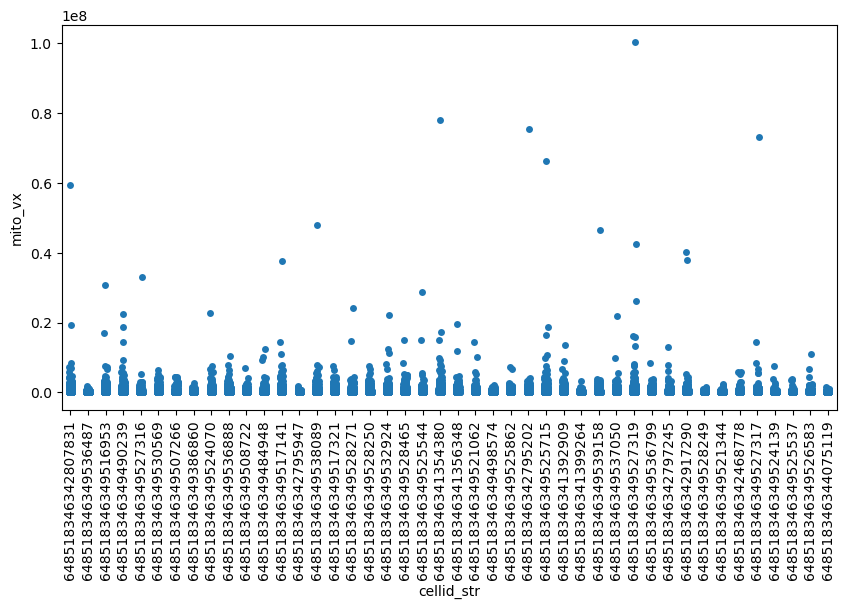

In [40]:
plt.figure(figsize=(10,5))
ax = sns.stripplot(mito_astrocytes, x='cellid_str', y='mito_vx')
plt.xticks(rotation=90)
plt.show()

In [41]:
fig = px.strip(mito_astrocytes, x="cellid_str", y="mito_vx", hover_data=['mito_id'])
fig.show()

In [42]:
astrocyte_list

[648518346341354380,
 648518346341356348,
 648518346341392909,
 648518346341399264,
 648518346342468778,
 648518346342795202,
 648518346342795947,
 648518346342797245,
 648518346342807831,
 648518346342917290,
 648518346344075119,
 648518346349386860,
 648518346349484948,
 648518346349490239,
 648518346349498574,
 648518346349507266,
 648518346349508722,
 648518346349516953,
 648518346349517141,
 648518346349517321,
 648518346349521062,
 648518346349521344,
 648518346349524070,
 648518346349524139,
 648518346349525537,
 648518346349525544,
 648518346349525715,
 648518346349525862,
 648518346349526583,
 648518346349527316,
 648518346349527317,
 648518346349527319,
 648518346349528249,
 648518346349528250,
 648518346349528271,
 648518346349528465,
 648518346349530569,
 648518346349532924,
 648518346349536487,
 648518346349536799,
 648518346349536888,
 648518346349537050,
 648518346349538089,
 648518346349539158]

In [43]:
astrocyte_list[0]

648518346341354380

In [44]:
mito[mito['cellid'] == astrocyte_list[0]]

,mito_id,mito_vx,ctr_pos_x_vx,ctr_pos_y_vx,ctr_pos_z_vx,bbox_beg_x_vx,bbox_beg_y_vx,bbox_beg_z_vx,bbox_end_x_vx,bbox_end_y_vx,bbox_end_z_vx,cellid,ctr_pos_x_nm,ctr_pos_y_nm,ctr_pos_z_nm,cellid_str
325,3094008,7493880,100658,61202,1860,97588,59934,1752,102422,61888,1980,648518346341354380,360355.64,219103.16,74400,648518346341354380
369,2645322,382336,89414,62878,1616,89324,62584,1609,89506,63134,1626,648518346341354380,320102.12,225103.24,64640,648518346341354380
392,3300338,1698756,102004,58992,2066,101374,58498,2045,102880,59598,2084,648518346341354380,365174.32,211191.36,82640,648518346341354380
1339,2744200,738340,89748,57166,2002,89626,57030,1977,89862,57330,2029,648518346341354380,321297.84,204654.28,80080,648518346341354380
2761,2755939,17322744,92404,62536,1964,90750,60096,1750,93446,65962,2157,648518346341354380,330806.32,223878.88,78560,648518346341354380
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2409468,2648799,1744916,88312,64342,1653,87932,63896,1629,88716,64710,1691,648518346341354380,316156.96,230344.36,66120,648518346341354380
2409485,3079568,1786308,96482,55894,1987,96176,55638,1929,96782,56478,2024,648518346341354380,345405.56,200100.52,79480,648518346341354380
2409519,2629658,1903396,88636,56388,1726,88454,55706,1676,88898,57120,1773,648518346341354380,317316.88,201869.04,69040,648518346341354380
2409536,2749168,1974356,90090,57886,1889,89702,57520,1814,90838,58854,2005,648518346341354380,322522.20,207231.88,75560,648518346341354380


In [45]:
len(astrocyte_list)

44

In [46]:
# Create a dictionary that has a df for each astro and its mitos
# call 'astro_' + str(cellid) to see or use the df

astro_iterator = {}
for i in range(len(astrocyte_list)):
    astro_iterator['astro_' + str(astrocyte_list[i])] = mito[mito['cellid'] == astrocyte_list[i]]

locals().update(astro_iterator)


In [47]:
#astro_iterator

In [48]:
astro_648518346341354380

,mito_id,mito_vx,ctr_pos_x_vx,ctr_pos_y_vx,ctr_pos_z_vx,bbox_beg_x_vx,bbox_beg_y_vx,bbox_beg_z_vx,bbox_end_x_vx,bbox_end_y_vx,bbox_end_z_vx,cellid,ctr_pos_x_nm,ctr_pos_y_nm,ctr_pos_z_nm,cellid_str
325,3094008,7493880,100658,61202,1860,97588,59934,1752,102422,61888,1980,648518346341354380,360355.64,219103.16,74400,648518346341354380
369,2645322,382336,89414,62878,1616,89324,62584,1609,89506,63134,1626,648518346341354380,320102.12,225103.24,64640,648518346341354380
392,3300338,1698756,102004,58992,2066,101374,58498,2045,102880,59598,2084,648518346341354380,365174.32,211191.36,82640,648518346341354380
1339,2744200,738340,89748,57166,2002,89626,57030,1977,89862,57330,2029,648518346341354380,321297.84,204654.28,80080,648518346341354380
2761,2755939,17322744,92404,62536,1964,90750,60096,1750,93446,65962,2157,648518346341354380,330806.32,223878.88,78560,648518346341354380
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2409468,2648799,1744916,88312,64342,1653,87932,63896,1629,88716,64710,1691,648518346341354380,316156.96,230344.36,66120,648518346341354380
2409485,3079568,1786308,96482,55894,1987,96176,55638,1929,96782,56478,2024,648518346341354380,345405.56,200100.52,79480,648518346341354380
2409519,2629658,1903396,88636,56388,1726,88454,55706,1676,88898,57120,1773,648518346341354380,317316.88,201869.04,69040,648518346341354380
2409536,2749168,1974356,90090,57886,1889,89702,57520,1814,90838,58854,2005,648518346341354380,322522.20,207231.88,75560,648518346341354380


In [49]:
astro_648518346341354380.mito_vx.median()

189856.0

In [50]:
str(astrocyte_list[0])

'648518346341354380'

In [51]:
astro_iterator.get('astro_'+ str(astrocyte_list[0])).mito_vx.median()

189856.0

In [52]:
astro_iterator.get('astro_'+ str(astrocyte_list[0])).mito_vx.mean()

535157.8412060301

In [53]:
astro_iterator.get('astro_'+ str(astrocyte_list[0])).mito_vx.skew()

24.70944616334014

# Median

In [54]:
# find the median mito_voxel for each astro

median_iterator = {}
for i in range(len(astrocyte_list)):
    median_iterator[str(astrocyte_list[i])] = astro_iterator.get('astro_'+ str(astrocyte_list[i])).mito_vx.median()
    
locals().update(median_iterator)

In [55]:
median_iterator

{'648518346341354380': 189856.0,
 '648518346341356348': 181220.0,
 '648518346341392909': 83112.0,
 '648518346341399264': 48980.0,
 '648518346342468778': 167828.0,
 '648518346342795202': 75036.0,
 '648518346342795947': 43108.0,
 '648518346342797245': 153940.0,
 '648518346342807831': 198372.0,
 '648518346342917290': 252984.0,
 '648518346344075119': 67836.0,
 '648518346349386860': 64408.0,
 '648518346349484948': 186268.0,
 '648518346349490239': 156104.0,
 '648518346349498574': 39066.0,
 '648518346349507266': 105484.0,
 '648518346349508722': 105296.0,
 '648518346349516953': 170980.0,
 '648518346349517141': 175648.0,
 '648518346349517321': 130532.0,
 '648518346349521062': 79840.0,
 '648518346349521344': 48256.0,
 '648518346349524070': 126548.0,
 '648518346349524139': 40692.0,
 '648518346349525537': 50766.0,
 '648518346349525544': 101936.0,
 '648518346349525715': 146896.0,
 '648518346349525862': 105064.0,
 '648518346349526583': 255276.0,
 '648518346349527316': 87440.0,
 '648518346349527317':

In [56]:
median_df = pd.DataFrame.from_dict(median_iterator, orient='index')
median_df.reset_index(inplace=True)
median_df.rename(columns = {'index':'cellid_str', 0:'median_mito_vx'}, inplace=True)
median_df_pareto = median_df.sort_values(by='median_mito_vx', ascending=False)
median_df_pareto

,cellid_str,median_mito_vx
28,648518346349526583,255276.0
9,648518346342917290,252984.0
31,648518346349527319,215378.0
8,648518346342807831,198372.0
0,648518346341354380,189856.0
12,648518346349484948,186268.0
1,648518346341356348,181220.0
34,648518346349528271,176924.0
18,648518346349517141,175648.0
17,648518346349516953,170980.0


In [57]:
median_df.dtypes

cellid_str         object
median_mito_vx    float64
dtype: object

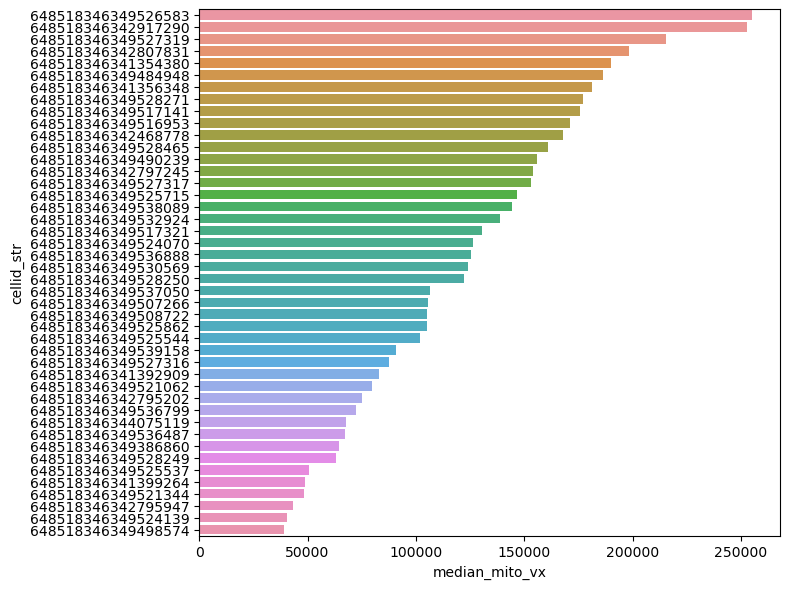

In [58]:
plt.figure(figsize=(8,6))
ax = sns.barplot(median_df_pareto, y='cellid_str', x='median_mito_vx')
#plt.xticks(rotation=90)
plt.tight_layout()
plt.show()

In [59]:
mito_astrocytes

,mito_id,mito_vx,ctr_pos_x_vx,ctr_pos_y_vx,ctr_pos_z_vx,bbox_beg_x_vx,bbox_beg_y_vx,bbox_beg_z_vx,bbox_end_x_vx,bbox_end_y_vx,bbox_end_z_vx,cellid,ctr_pos_x_nm,ctr_pos_y_nm,ctr_pos_z_nm,cellid_str
17,3382195,631276,103578,46884,1395,103432,46578,1382,103766,47140,1410,648518346342807831,370809.24,167844.72,55800,648518346342807831
19,809674,1280360,57366,67234,44,56430,66442,21,58286,67920,66,648518346349536487,205370.28,240697.72,1760,648518346349536487
26,3272501,381568,101722,46372,256,101402,46284,244,102076,46462,273,648518346349516953,364164.76,166011.76,10240,648518346349516953
28,2269990,297224,83304,51466,980,83152,51152,974,83486,51694,987,648518346349490239,298228.32,184248.28,39200,648518346349490239
32,3506710,551480,105880,53960,735,105668,53674,723,106108,54266,751,648518346349516953,379050.40,193176.80,29400,648518346349516953
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2409606,2124797,3142128,80942,39796,752,80710,39012,687,81228,40508,855,648518346342797245,289772.36,142469.68,30080,648518346342797245
2409608,2079446,3448732,77794,72900,1636,77162,72282,1563,78488,73242,1698,648518346349525537,278502.52,260982.00,65440,648518346349525537
2409611,2864896,3878784,93134,59860,836,93000,59406,798,93294,60294,867,648518346349536888,333419.72,214298.80,33440,648518346349536888
2409612,2161774,4075748,80312,56522,1814,79536,55348,1714,80940,57054,1889,648518346349524070,287516.96,202348.76,72560,648518346349524070


In [60]:
# merge with mito_astrocytes df

mito_astrocytes_median = pd.merge(mito_astrocytes, median_df, on='cellid_str', how='inner')
mito_astrocytes_median

,mito_id,mito_vx,ctr_pos_x_vx,ctr_pos_y_vx,ctr_pos_z_vx,bbox_beg_x_vx,bbox_beg_y_vx,bbox_beg_z_vx,bbox_end_x_vx,bbox_end_y_vx,bbox_end_z_vx,cellid,ctr_pos_x_nm,ctr_pos_y_nm,ctr_pos_z_nm,cellid_str,median_mito_vx
0,3382195,631276,103578,46884,1395,103432,46578,1382,103766,47140,1410,648518346342807831,370809.24,167844.72,55800,648518346342807831,198372.0
1,3259079,540000,101736,40496,1061,101584,40278,1047,101964,40812,1078,648518346342807831,364214.88,144975.68,42440,648518346342807831,198372.0
2,3376366,4726860,104144,44422,1312,102296,43338,1270,105492,45234,1398,648518346342807831,372835.52,159030.76,52480,648518346342807831,198372.0
3,2723586,721876,90620,48158,1091,90230,47834,1080,90996,48450,1110,648518346342807831,324419.60,172405.64,43640,648518346342807831,198372.0
4,2711140,59419932,95316,43668,1090,90366,41518,684,99206,47828,1489,648518346342807831,341231.28,156331.44,43600,648518346342807831,198372.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
41838,3547422,553724,104158,73016,307,103938,72756,261,104528,73286,347,648518346344075119,372885.64,261397.28,12280,648518346344075119,67836.0
41839,3553003,575740,105398,73976,821,105148,73844,806,105564,74126,837,648518346344075119,377324.84,264834.08,32840,648518346344075119,67836.0
41840,3333823,600772,100676,74530,641,99826,74426,614,101622,74718,666,648518346344075119,360420.08,266817.40,25640,648518346344075119,67836.0
41841,3443214,905744,103028,74574,569,102744,74262,530,103318,74882,595,648518346344075119,368840.24,266974.92,22760,648518346344075119,67836.0


In [61]:
astro_plot = mito_astrocytes_median.sort_values(by='median_mito_vx', ascending=False)
astro_plot

,mito_id,mito_vx,ctr_pos_x_vx,ctr_pos_y_vx,ctr_pos_z_vx,bbox_beg_x_vx,bbox_beg_y_vx,bbox_beg_z_vx,bbox_end_x_vx,bbox_end_y_vx,bbox_end_z_vx,cellid,ctr_pos_x_nm,ctr_pos_y_nm,ctr_pos_z_nm,cellid_str,median_mito_vx
41481,2938643,606792,95714,42398,1701,95426,42074,1685,96032,42664,1720,648518346349526583,342656.12,151784.84,68040,648518346349526583,255276.0
41490,3048751,227660,96528,41446,2109,96422,41368,2102,96640,41530,2117,648518346349526583,345570.24,148376.68,84360,648518346349526583,255276.0
41476,2821422,182520,92066,40566,1582,91942,40510,1572,92196,40620,1594,648518346349526583,329596.28,145226.28,63280,648518346349526583,255276.0
41477,3161261,401100,99682,44022,1588,99540,43930,1575,99818,44128,1603,648518346349526583,356861.56,157598.76,63520,648518346349526583,255276.0
41478,3043465,190504,96080,38962,1500,95954,38894,1490,96188,39018,1511,648518346349526583,343966.40,139483.96,60000,648518346349526583,255276.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
27757,2155999,9296,80414,54902,215,80380,54864,210,80458,54926,222,648518346349498574,287882.12,196549.16,8600,648518346349498574,39066.0
27758,2517297,9348,85732,58426,80,85690,58390,79,85784,58470,84,648518346349498574,306920.56,209165.08,3200,648518346349498574,39066.0
27759,1083027,25080,61834,40802,1588,61740,40722,1585,61918,40856,1595,648518346349498574,221365.72,146071.16,63520,648518346349498574,39066.0
27760,2160909,9564,80786,57122,86,80752,57092,83,80818,57150,91,648518346349498574,289213.88,204496.76,3440,648518346349498574,39066.0


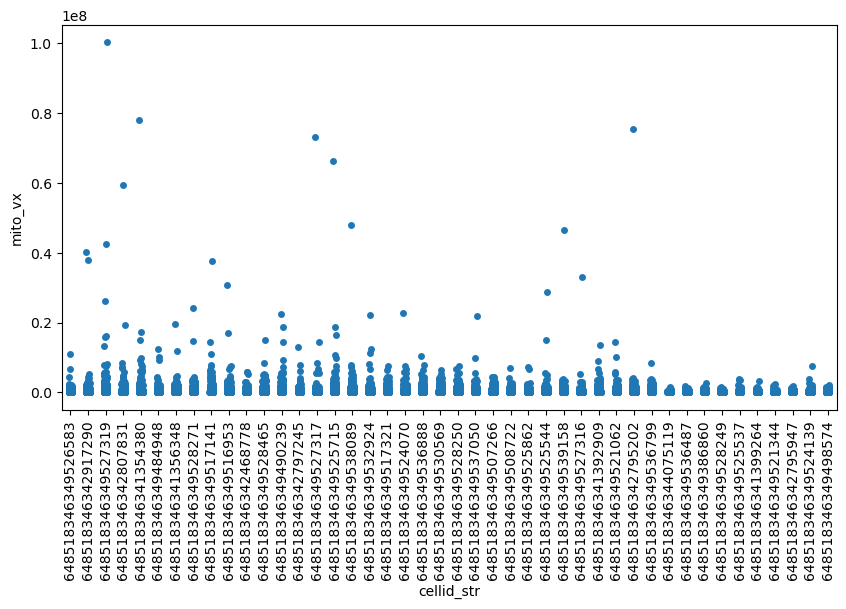

In [62]:
plt.figure(figsize=(10,5))
ax = sns.stripplot(astro_plot, x='cellid_str', y='mito_vx')
plt.xticks(rotation=90)
plt.show()

In [63]:
fig = px.strip(astro_plot, x="cellid_str", y="mito_vx", hover_data=['mito_id'])
fig.show()

# Mean

In [64]:
# find the mean mito_voxel for each astro

mean_iterator = {}
for i in range(len(astrocyte_list)):
    mean_iterator[str(astrocyte_list[i])] = astro_iterator.get('astro_'+ str(astrocyte_list[i])).mito_vx.mean()
    
locals().update(mean_iterator)

In [65]:
mean_iterator

{'648518346341354380': 535157.8412060301,
 '648518346341356348': 470788.4496124031,
 '648518346341392909': 263421.7432024169,
 '648518346341399264': 169424.42687747037,
 '648518346342468778': 552108.9285714285,
 '648518346342795202': 257677.54808444096,
 '648518346342795947': 105608.94117647059,
 '648518346342797245': 359630.9389312977,
 '648518346342807831': 512316.40774719673,
 '648518346342917290': 670064.8564476885,
 '648518346344075119': 133991.95652173914,
 '648518346349386860': 147149.40665701882,
 '648518346349484948': 391838.3157894737,
 '648518346349490239': 394499.84022424667,
 '648518346349498574': 112168.56807511736,
 '648518346349507266': 286877.0276008493,
 '648518346349508722': 216243.39865370232,
 '648518346349516953': 369679.8309509012,
 '648518346349517141': 395680.5404682274,
 '648518346349517321': 286376.4805091488,
 '648518346349521062': 269643.1933962264,
 '648518346349521344': 135957.4957507082,
 '648518346349524070': 345754.5516549649,
 '648518346349524139': 11

In [66]:
mean_df = pd.DataFrame.from_dict(mean_iterator, orient='index')
mean_df.reset_index(inplace=True)
mean_df.rename(columns = {'index':'cellid_str', 0:'mean_mito_vx'}, inplace=True)
mean_df_pareto = mean_df.sort_values(by='mean_mito_vx', ascending=False)
mean_df_pareto

,cellid_str,mean_mito_vx
31,648518346349527319,749230.299539
9,648518346342917290,670064.856448
4,648518346342468778,552108.928571
30,648518346349527317,545822.666667
0,648518346341354380,535157.841206
8,648518346342807831,512316.407747
28,648518346349526583,503073.522267
1,648518346341356348,470788.449612
34,648518346349528271,395737.581967
18,648518346349517141,395680.540468


In [67]:
mean_df.dtypes

cellid_str       object
mean_mito_vx    float64
dtype: object

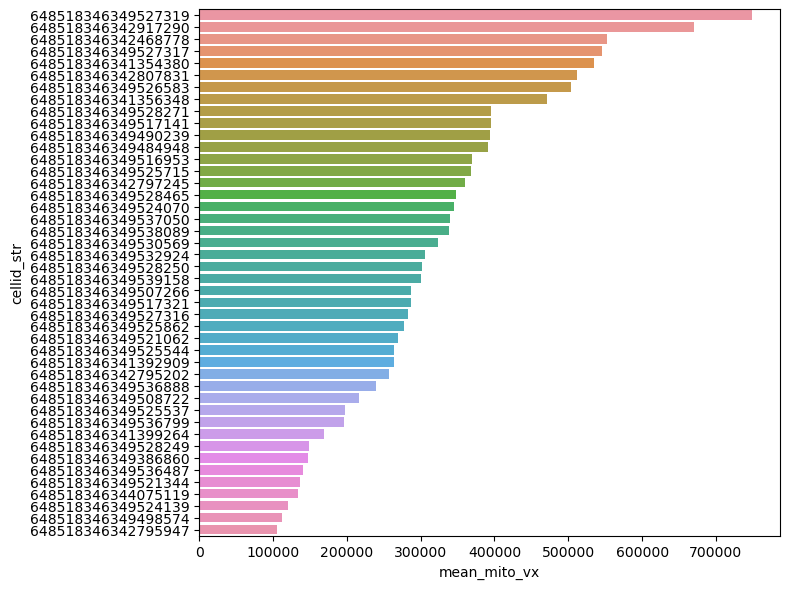

In [68]:
plt.figure(figsize=(8,6))
ax = sns.barplot(mean_df_pareto, y='cellid_str', x='mean_mito_vx')
#plt.xticks(rotation=90)
plt.tight_layout()
plt.show()

In [69]:
# merge with mito_astrocytes df

mito_astrocytes_mean = pd.merge(mito_astrocytes, mean_df, on='cellid_str', how='inner')
mito_astrocytes_mean

,mito_id,mito_vx,ctr_pos_x_vx,ctr_pos_y_vx,ctr_pos_z_vx,bbox_beg_x_vx,bbox_beg_y_vx,bbox_beg_z_vx,bbox_end_x_vx,bbox_end_y_vx,bbox_end_z_vx,cellid,ctr_pos_x_nm,ctr_pos_y_nm,ctr_pos_z_nm,cellid_str,mean_mito_vx
0,3382195,631276,103578,46884,1395,103432,46578,1382,103766,47140,1410,648518346342807831,370809.24,167844.72,55800,648518346342807831,512316.407747
1,3259079,540000,101736,40496,1061,101584,40278,1047,101964,40812,1078,648518346342807831,364214.88,144975.68,42440,648518346342807831,512316.407747
2,3376366,4726860,104144,44422,1312,102296,43338,1270,105492,45234,1398,648518346342807831,372835.52,159030.76,52480,648518346342807831,512316.407747
3,2723586,721876,90620,48158,1091,90230,47834,1080,90996,48450,1110,648518346342807831,324419.60,172405.64,43640,648518346342807831,512316.407747
4,2711140,59419932,95316,43668,1090,90366,41518,684,99206,47828,1489,648518346342807831,341231.28,156331.44,43600,648518346342807831,512316.407747
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
41838,3547422,553724,104158,73016,307,103938,72756,261,104528,73286,347,648518346344075119,372885.64,261397.28,12280,648518346344075119,133991.956522
41839,3553003,575740,105398,73976,821,105148,73844,806,105564,74126,837,648518346344075119,377324.84,264834.08,32840,648518346344075119,133991.956522
41840,3333823,600772,100676,74530,641,99826,74426,614,101622,74718,666,648518346344075119,360420.08,266817.40,25640,648518346344075119,133991.956522
41841,3443214,905744,103028,74574,569,102744,74262,530,103318,74882,595,648518346344075119,368840.24,266974.92,22760,648518346344075119,133991.956522


In [70]:
astro_plot_mean = mito_astrocytes_mean.sort_values(by='mean_mito_vx', ascending=False)
astro_plot_mean

,mito_id,mito_vx,ctr_pos_x_vx,ctr_pos_y_vx,ctr_pos_z_vx,bbox_beg_x_vx,bbox_beg_y_vx,bbox_beg_z_vx,bbox_end_x_vx,bbox_end_y_vx,bbox_end_z_vx,cellid,ctr_pos_x_nm,ctr_pos_y_nm,ctr_pos_z_nm,cellid_str,mean_mito_vx
36193,1074956,783304,61470,38634,1103,61110,38336,1065,61982,38910,1130,648518346349527319,220062.60,138309.72,44120,648518346349527319,749230.299539
36297,1423294,204924,68186,39446,1748,68050,39356,1739,68308,39638,1760,648518346349527319,244105.88,141216.68,69920,648518346349527319,749230.299539
36286,968852,395800,59970,39760,1087,59780,39516,1062,60314,40024,1113,648518346349527319,214692.60,142340.80,43480,648518346349527319,749230.299539
36287,1546699,197892,69774,43170,2018,69708,43052,2008,69834,43260,2031,648518346349527319,249790.92,154548.60,80720,648518346349527319,749230.299539
36288,1422151,198036,67046,38992,1343,66972,38876,1334,67136,39114,1353,648518346349527319,240024.68,139591.36,53720,648518346349527319,749230.299539
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15748,3857695,122580,111678,60548,143,111590,60380,137,111772,60680,150,648518346342795947,399807.24,216761.84,5720,648518346342795947,105608.941176
15747,3975569,122300,112418,61460,176,112232,61406,160,112604,61508,185,648518346342795947,402456.44,220026.80,7040,648518346342795947,105608.941176
15746,4091943,120920,114276,61846,129,114154,61798,119,114414,61890,136,648518346342795947,409108.08,221408.68,5160,648518346342795947,105608.941176
15745,3966837,119460,113158,58828,192,113002,58772,188,113372,58872,197,648518346342795947,405105.64,210604.24,7680,648518346342795947,105608.941176


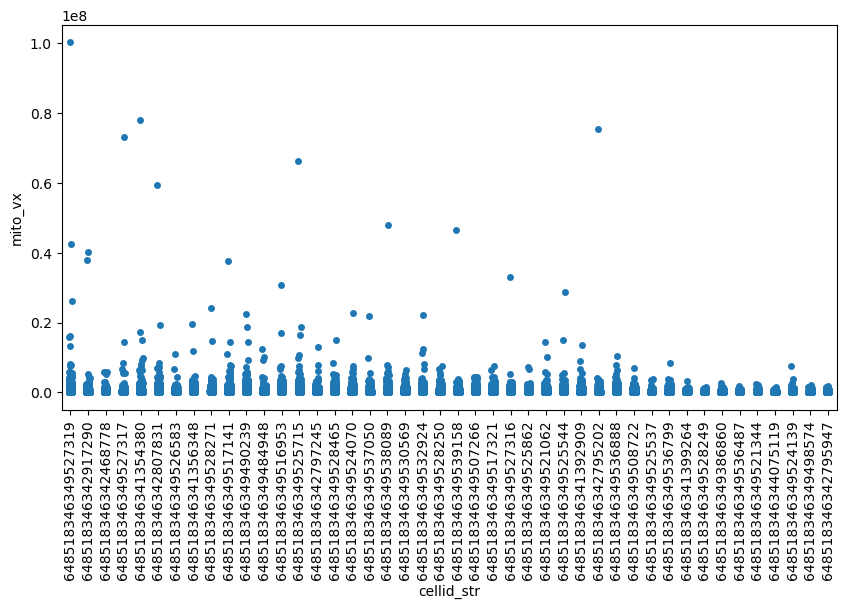

In [71]:
plt.figure(figsize=(10,5))
ax = sns.stripplot(astro_plot_mean, x='cellid_str', y='mito_vx')
plt.xticks(rotation=90)
plt.show()

In [72]:
thresh=2000000
fig = px.strip(astro_plot_mean, x="cellid_str", y="mito_vx", hover_data=['mito_id'], log_y=True)
fig.update_traces(marker=dict(color='black'))
fig.add_hrect(y0=thresh, y1=130000000, line_width=0, fillcolor="blue", opacity=0.5)
fig.add_hrect(y0=1000, y1=thresh, line_width=0, fillcolor="red", opacity=0.4)
fig.show()

In [73]:
sort_mean = mean_df.sort_values(by='mean_mito_vx', ascending=False)
sort_mean.cellid_str.to_list()

['648518346349527319',
 '648518346342917290',
 '648518346342468778',
 '648518346349527317',
 '648518346341354380',
 '648518346342807831',
 '648518346349526583',
 '648518346341356348',
 '648518346349528271',
 '648518346349517141',
 '648518346349490239',
 '648518346349484948',
 '648518346349516953',
 '648518346349525715',
 '648518346342797245',
 '648518346349528465',
 '648518346349524070',
 '648518346349537050',
 '648518346349538089',
 '648518346349530569',
 '648518346349532924',
 '648518346349528250',
 '648518346349539158',
 '648518346349507266',
 '648518346349517321',
 '648518346349527316',
 '648518346349525862',
 '648518346349521062',
 '648518346349525544',
 '648518346341392909',
 '648518346342795202',
 '648518346349536888',
 '648518346349508722',
 '648518346349525537',
 '648518346349536799',
 '648518346341399264',
 '648518346349528249',
 '648518346349386860',
 '648518346349536487',
 '648518346349521344',
 '648518346344075119',
 '648518346349524139',
 '648518346349498574',
 '648518346

In [74]:
sort_list = sort_mean.cellid_str.to_list()[-10:]
sort_list

['648518346349536799',
 '648518346341399264',
 '648518346349528249',
 '648518346349386860',
 '648518346349536487',
 '648518346349521344',
 '648518346344075119',
 '648518346349524139',
 '648518346349498574',
 '648518346342795947']

In [75]:
sort_list_int = [int(i) for i in sort_list]
sort_list_int

[648518346349536799,
 648518346341399264,
 648518346349528249,
 648518346349386860,
 648518346349536487,
 648518346349521344,
 648518346344075119,
 648518346349524139,
 648518346349498574,
 648518346342795947]

Example: astro 648518346342795947
- Smallest mean of mito_vx of all astrocytes
- Contacts two blood vessels cellids 648518346342804483 and 648518346348121670
- View in [Neuroglancer](https://neuromancer-seung-import.appspot.com/#!%7B%22layers%22:%5B%7B%22source%22:%22precomputed://gs://microns_public_datasets/pinky100_v0/son_of_alignment_v15_rechunked%22%2C%22type%22:%22image%22%2C%22blend%22:%22default%22%2C%22shaderControls%22:%7B%7D%2C%22name%22:%22EM%22%7D%2C%7B%22source%22:%22precomputed://gs://microns_public_datasets/pinky100_v185/seg%22%2C%22type%22:%22segmentation%22%2C%22selectedAlpha%22:0.51%2C%22objectAlpha%22:0.25%2C%22segments%22:%5B%22648518346342804483%22%2C%22648518346348121670%22%5D%2C%22hiddenSegments%22:%5B%22648518346342795947%22%5D%2C%22skeletonRendering%22:%7B%22mode2d%22:%22lines_and_points%22%2C%22mode3d%22:%22lines%22%7D%2C%22name%22:%22cell_segmentation_v185%22%7D%2C%7B%22source%22:%22precomputed://matrix://sseung-archive/pinky100-clefts/mip1_d2_1175k%22%2C%22type%22:%22segmentation%22%2C%22skeletonRendering%22:%7B%22mode2d%22:%22lines_and_points%22%2C%22mode3d%22:%22lines%22%7D%2C%22name%22:%22synapses%22%7D%2C%7B%22source%22:%22precomputed://matrix://sseung-archive/pinky100-mito/seg_191220%22%2C%22type%22:%22segmentation%22%2C%22segments%22:%5B%222888454%22%2C%223104596%22%2C%223404859%22%2C%223405444%22%2C%223405471%22%2C%223405556%22%2C%223405568%22%2C%223405596%22%2C%223405667%22%2C%223405721%22%2C%223405723%22%2C%223410083%22%2C%223410297%22%2C%223415345%22%2C%223506765%22%2C%223514686%22%2C%223514919%22%2C%223514942%22%2C%223514952%22%2C%223514954%22%2C%223515021%22%2C%223515038%22%2C%223515041%22%2C%223515065%22%2C%223515070%22%2C%223515150%22%2C%223515191%22%2C%223515251%22%2C%223515323%22%2C%223515481%22%2C%223515511%22%2C%223515531%22%2C%223515587%22%2C%223515645%22%2C%223515683%22%2C%223515710%22%2C%223515757%22%2C%223515787%22%2C%223515794%22%2C%223515795%22%2C%223515825%22%2C%223515912%22%2C%223515942%22%2C%223515982%22%2C%223518822%22%2C%223518844%22%2C%223518913%22%2C%223518919%22%2C%223518980%22%2C%223519202%22%2C%223519354%22%2C%223519358%22%2C%223519426%22%2C%223519940%22%2C%223520276%22%2C%223520706%22%2C%223520747%22%2C%223524636%22%2C%223524780%22%2C%223524855%22%2C%223524917%22%2C%223525211%22%2C%223525326%22%2C%223525456%22%2C%223525528%22%2C%223525566%22%2C%223525676%22%2C%223525702%22%2C%223525759%22%2C%223525765%22%2C%223525799%22%2C%223529455%22%2C%223530082%22%2C%223536661%22%2C%223536862%22%2C%223542152%22%2C%223610383%22%2C%223610460%22%2C%223613924%22%2C%223614910%22%2C%223615687%22%2C%223618294%22%2C%223618335%22%2C%223618343%22%2C%223618401%22%2C%223618501%22%2C%223618582%22%2C%223618930%22%2C%223619054%22%2C%223619504%22%2C%223619679%22%2C%223619965%22%2C%223620136%22%2C%223620327%22%2C%223620333%22%2C%223620422%22%2C%223623574%22%2C%223623814%22%2C%223623979%22%2C%223624039%22%2C%223624043%22%2C%223624340%22%2C%223624398%22%2C%223624548%22%2C%223624676%22%2C%223624723%22%2C%223624736%22%2C%223624758%22%2C%223624889%22%2C%223625150%22%2C%223625234%22%2C%223625250%22%2C%223628059%22%2C%223628124%22%2C%223628137%22%2C%223628148%22%2C%223628221%22%2C%223628311%22%2C%223628342%22%2C%223628366%22%2C%223628372%22%2C%223628422%22%2C%223628447%22%2C%223628543%22%2C%223628647%22%2C%223628672%22%2C%223628685%22%2C%223628726%22%2C%223628899%22%2C%223629057%22%2C%223629167%22%2C%223629173%22%2C%223629212%22%2C%223629286%22%2C%223629454%22%2C%223629517%22%2C%223629524%22%2C%223629541%22%2C%223629568%22%2C%223629578%22%2C%223632191%22%2C%223632274%22%2C%223632458%22%2C%223632737%22%2C%223633134%22%2C%223633157%22%2C%223633171%22%2C%223633192%22%2C%223633293%22%2C%223633381%22%2C%223633436%22%2C%223633682%22%2C%223633742%22%2C%223633859%22%2C%223633970%22%2C%223636645%22%2C%223636685%22%2C%223636775%22%2C%223636782%22%2C%223636925%22%2C%223636980%22%2C%223637205%22%2C%223637268%22%2C%223637280%22%2C%223637305%22%2C%223637845%22%2C%223637901%22%2C%223637940%22%2C%223637968%22%2C%223638151%22%2C%223638164%22%2C%223638264%22%2C%223638280%22%2C%223638294%22%2C%223638446%22%2C%223638477%22%2C%223642069%22%2C%223642542%22%2C%223642728%22%2C%223642973%22%2C%223643100%22%2C%223643273%22%2C%223643342%22%2C%223653778%22%2C%223659575%22%2C%223660071%22%2C%223731608%22%2C%223732080%22%2C%223732214%22%2C%223732337%22%2C%223735255%22%2C%223735342%22%2C%223735404%22%2C%223735429%22%2C%223735450%22%2C%223735503%22%2C%223735560%22%2C%223735601%22%2C%223735604%22%2C%223735631%22%2C%223735661%22%2C%223735676%22%2C%223735680%22%2C%223735717%22%2C%223735730%22%2C%223735732%22%2C%223735783%22%2C%223735799%22%2C%223735961%22%2C%223736128%22%2C%223736156%22%2C%223736204%22%2C%223736212%22%2C%223736215%22%2C%223736224%22%2C%223736268%22%2C%223736269%22%2C%223736319%22%2C%223736326%22%2C%223736358%22%2C%223736383%22%2C%223736391%22%2C%223736521%22%2C%223736551%22%2C%223736681%22%2C%223736996%22%2C%223737046%22%2C%223737273%22%2C%223739950%22%2C%223739961%22%2C%223740000%22%2C%223740235%22%2C%223740289%22%2C%223740290%22%2C%223740328%22%2C%223740383%22%2C%223740455%22%2C%223740459%22%2C%223740481%22%2C%223740508%22%2C%223740525%22%2C%223740534%22%2C%223740560%22%2C%223740570%22%2C%223740576%22%2C%223740623%22%2C%223740644%22%2C%223740666%22%2C%223740730%22%2C%223740738%22%2C%223740805%22%2C%223740831%22%2C%223740833%22%2C%223740888%22%2C%223740957%22%2C%223740958%22%2C%223740996%22%2C%223741009%22%2C%223741025%22%2C%223741046%22%2C%223741068%22%2C%223741075%22%2C%223741086%22%2C%223741093%22%2C%223741132%22%2C%223741143%22%2C%223741160%22%2C%223741182%22%2C%223741184%22%2C%223741205%22%2C%223741237%22%2C%223741245%22%2C%223741251%22%2C%223741270%22%2C%223741271%22%2C%223741287%22%2C%223741329%22%2C%223741362%22%2C%223741385%22%2C%223741402%22%2C%223741413%22%2C%223741419%22%2C%223741470%22%2C%223741517%22%2C%223741653%22%2C%223741743%22%2C%223741769%22%2C%223744718%22%2C%223744723%22%2C%223744786%22%2C%223744789%22%2C%223744805%22%2C%223744822%22%2C%223744835%22%2C%223744839%22%2C%223744849%22%2C%223744867%22%2C%223744897%22%2C%223744910%22%2C%223744918%22%2C%223744919%22%2C%223744932%22%2C%223744947%22%2C%223744951%22%2C%223744998%22%2C%223745008%22%2C%223745120%22%2C%223745137%22%2C%223745366%22%2C%223745379%22%2C%223745462%22%2C%223745520%22%2C%223745545%22%2C%223745556%22%2C%223745558%22%2C%223745606%22%2C%223745649%22%2C%223745662%22%2C%223745677%22%2C%223745695%22%2C%223745770%22%2C%223745974%22%2C%223745986%22%2C%223746060%22%2C%223746080%22%2C%223746103%22%2C%223746109%22%2C%223746127%22%2C%223746239%22%2C%223746240%22%2C%223746267%22%2C%223746313%22%2C%223746379%22%2C%223746441%22%2C%223749312%22%2C%223749393%22%2C%223749442%22%2C%223749525%22%2C%223749543%22%2C%223749556%22%2C%223749574%22%2C%223749585%22%2C%223749645%22%2C%223749695%22%2C%223749773%22%2C%223750030%22%2C%223750528%22%2C%223750541%22%2C%223750608%22%2C%223750835%22%2C%223750878%22%2C%223750981%22%2C%223750982%22%2C%223751011%22%2C%223751025%22%2C%223751220%22%2C%223751250%22%2C%223751265%22%2C%223751338%22%2C%223751368%22%2C%223754510%22%2C%223754989%22%2C%223755283%22%2C%223755597%22%2C%223755796%22%2C%223755908%22%2C%223756086%22%2C%223756134%22%2C%223756139%22%2C%223756244%22%2C%223756269%22%2C%223756292%22%2C%223756293%22%2C%223756642%22%2C%223756742%22%2C%223761107%22%2C%223778390%22%2C%223843705%22%2C%223843833%22%2C%223844045%22%2C%223844066%22%2C%223844105%22%2C%223844143%22%2C%223844240%22%2C%223847865%22%2C%223847969%22%2C%223847995%22%2C%223848756%22%2C%223848981%22%2C%223852086%22%2C%223852179%22%2C%223852304%22%2C%223852334%22%2C%223852446%22%2C%223852603%22%2C%223852737%22%2C%223852743%22%2C%223852756%22%2C%223852820%22%2C%223852883%22%2C%223852888%22%2C%223852902%22%2C%223852920%22%2C%223852943%22%2C%223852984%22%2C%223853029%22%2C%223853079%22%2C%223853092%22%2C%223853197%22%2C%223853200%22%2C%223853279%22%2C%223853334%22%2C%223853340%22%2C%223853355%22%2C%223853359%22%2C%223853374%22%2C%223853375%22%2C%223853376%22%2C%223853377%22%2C%223853393%22%2C%223853405%22%2C%223853414%22%2C%223853448%22%2C%223853458%22%2C%223853460%22%2C%223853476%22%2C%223853516%22%2C%223853540%22%2C%223853566%22%2C%223853635%22%2C%223853692%22%2C%223853705%22%2C%223853753%22%2C%223853896%22%2C%223853963%22%2C%223856440%22%2C%223856509%22%2C%223856529%22%2C%223856541%22%2C%223856546%22%2C%223856568%22%2C%223856586%22%2C%223856593%22%2C%223856602%22%2C%223856622%22%2C%223856630%22%2C%223856641%22%2C%223856651%22%2C%223856667%22%2C%223856668%22%2C%223856685%22%2C%223856759%22%2C%223856820%22%2C%223856842%22%2C%223856851%22%2C%223856895%22%2C%223856937%22%2C%223856945%22%2C%223856959%22%2C%223857001%22%2C%223857030%22%2C%223857056%22%2C%223857104%22%2C%223857136%22%2C%223857165%22%2C%223857171%22%2C%223857183%22%2C%223857222%22%2C%223857270%22%2C%223857320%22%2C%223857338%22%2C%223857343%22%2C%223857387%22%2C%223857396%22%2C%223857405%22%2C%223857412%22%2C%223857500%22%2C%223857540%22%2C%223857568%22%2C%223857601%22%2C%223857605%22%2C%223857695%22%2C%223857731%22%2C%223857735%22%2C%223857768%22%2C%223857782%22%2C%223857787%22%2C%223857796%22%2C%223857859%22%2C%223857878%22%2C%223857884%22%2C%223857899%22%2C%223857912%22%2C%223857915%22%2C%223857930%22%2C%223860818%22%2C%223860832%22%2C%223860856%22%2C%223860911%22%2C%223860956%22%2C%223860957%22%2C%223861028%22%2C%223861096%22%2C%223861099%22%2C%223861179%22%2C%223861538%22%2C%223861813%22%2C%223861825%22%2C%223861830%22%2C%223861839%22%2C%223861847%22%2C%223861851%22%2C%223861866%22%2C%223861884%22%2C%223861910%22%2C%223861969%22%2C%223861982%22%2C%223861992%22%2C%223862005%22%2C%223862009%22%2C%223862033%22%2C%223862135%22%2C%223862155%22%2C%223862233%22%2C%223862237%22%2C%223862263%22%2C%223862274%22%2C%223862278%22%2C%223862304%22%2C%223862357%22%2C%223862380%22%2C%223862422%22%2C%223862457%22%2C%223862510%22%2C%223865426%22%2C%223865475%22%2C%223865581%22%2C%223865618%22%2C%223865660%22%2C%223865822%22%2C%223866107%22%2C%223866342%22%2C%223866389%22%2C%223866408%22%2C%223866545%22%2C%223866584%22%2C%223866594%22%2C%223866635%22%2C%223866954%22%2C%223875559%22%2C%223887265%22%2C%223892888%22%2C%223957840%22%2C%223957919%22%2C%223958109%22%2C%223958113%22%2C%223958453%22%2C%223958614%22%2C%223961566%22%2C%223961669%22%2C%223961803%22%2C%223961829%22%2C%223961892%22%2C%223961918%22%2C%223961952%22%2C%223961954%22%2C%223961972%22%2C%223961996%22%2C%223962018%22%2C%223962052%22%2C%223962068%22%2C%223962073%22%2C%223962101%22%2C%223962185%22%2C%223962276%22%2C%223962328%22%2C%223962353%22%2C%223962367%22%2C%223962383%22%2C%223962518%22%2C%223962565%22%2C%223962604%22%2C%223962635%22%2C%223962678%22%2C%223962815%22%2C%223965711%22%2C%223965715%22%2C%223965756%22%2C%223965780%22%2C%223965863%22%2C%223965943%22%2C%223965981%22%2C%223965983%22%2C%223966135%22%2C%223966193%22%2C%223966239%22%2C%223966296%22%2C%223966301%22%2C%223966374%22%2C%223966397%22%2C%223966405%22%2C%223966416%22%2C%223966450%22%2C%223966453%22%2C%223966459%22%2C%223966558%22%2C%223966695%22%2C%223966765%22%2C%223966823%22%2C%223966837%22%2C%223966908%22%2C%223966934%22%2C%223967061%22%2C%223967084%22%2C%223967189%22%2C%223967203%22%2C%223967219%22%2C%223967292%22%2C%223967393%22%2C%223967402%22%2C%223967442%22%2C%223967484%22%2C%223967604%22%2C%223967675%22%2C%223967736%22%2C%223967829%22%2C%223967926%22%2C%223970300%22%2C%223970302%22%2C%223970370%22%2C%223970884%22%2C%223971082%22%2C%223971200%22%2C%223971210%22%2C%223971314%22%2C%223971315%22%2C%223971437%22%2C%223971602%22%2C%223975332%22%2C%223975569%22%2C%223975586%22%2C%223975600%22%2C%223975665%22%2C%223975707%22%2C%223975730%22%2C%223975807%22%2C%223975853%22%2C%223976067%22%2C%223976106%22%2C%223976187%22%2C%223976208%22%2C%223976380%22%2C%223976397%22%2C%223976517%22%2C%223976524%22%2C%223976540%22%2C%223976857%22%2C%223979733%22%2C%223979736%22%2C%223979805%22%2C%223979826%22%2C%223980123%22%2C%223980171%22%2C%223980229%22%2C%223981036%22%2C%223981071%22%2C%223981072%22%2C%223985243%22%2C%224007603%22%2C%224073647%22%2C%224073847%22%2C%224073932%22%2C%224074366%22%2C%224074488%22%2C%224074513%22%2C%224077444%22%2C%224077543%22%2C%224077602%22%2C%224077693%22%2C%224077696%22%2C%224078071%22%2C%224078099%22%2C%224078131%22%2C%224078146%22%2C%224078199%22%2C%224078250%22%2C%224078301%22%2C%224078913%22%2C%224079362%22%2C%224082429%22%2C%224082451%22%2C%224082470%22%2C%224082622%22%2C%224082796%22%2C%224082805%22%2C%224082830%22%2C%224082886%22%2C%224082921%22%2C%224083057%22%2C%224083123%22%2C%224083246%22%2C%224083249%22%2C%224083278%22%2C%224083349%22%2C%224083360%22%2C%224083382%22%2C%224083509%22%2C%224083557%22%2C%224083639%22%2C%224083660%22%2C%224083711%22%2C%224083799%22%2C%224083849%22%2C%224083908%22%2C%224083977%22%2C%224084038%22%2C%224084114%22%2C%224084126%22%2C%224087974%22%2C%224088252%22%2C%224088286%22%2C%224088465%22%2C%224091943%22%2C%224092170%22%2C%224092258%22%2C%224093348%22%2C%224101378%22%2C%224101430%22%2C%224101584%22%2C%224101597%22%2C%224101630%22%5D%2C%22skeletonRendering%22:%7B%22mode2d%22:%22lines_and_points%22%2C%22mode3d%22:%22lines%22%7D%2C%22name%22:%22mitochondria%22%7D%2C%7B%22source%22:%22precomputed://matrix://sseung-archive/pinky100-nuclei/seg%22%2C%22type%22:%22segmentation%22%2C%22skeletonRendering%22:%7B%22mode2d%22:%22lines_and_points%22%2C%22mode3d%22:%22lines%22%7D%2C%22name%22:%22nuclei%22%7D%5D%2C%22navigation%22:%7B%22pose%22:%7B%22position%22:%7B%22voxelSize%22:%5B4%2C4%2C40%5D%2C%22voxelCoordinates%22:%5B109244%2C60456%2C470%5D%7D%7D%2C%22zoomFactor%22:383.0066650796121%7D%2C%22perspectiveOrientation%22:%5B0%2C1%2C0%2C0%5D%2C%22perspectiveZoom%22:904.6914987128356%2C%22showSlices%22:false%2C%22selectedLayer%22:%7B%22layer%22:%22cell_segmentation_v185%22%2C%22visible%22:true%7D%2C%22layout%22:%7B%22type%22:%223d%22%2C%22orthographicProjection%22:true%7D%7D)

# Standard deviation

In [76]:
# find the std mito_voxel for each astro

std_iterator = {}
for i in range(len(astrocyte_list)):
    std_iterator[str(astrocyte_list[i])] = astro_iterator.get('astro_'+ str(astrocyte_list[i])).mito_vx.std()
    
locals().update(std_iterator)

In [77]:
std_iterator

{'648518346341354380': 2692999.4471317697,
 '648518346341356348': 1148963.837860824,
 '648518346341392909': 651061.5733465264,
 '648518346341399264': 313569.8647765877,
 '648518346342468778': 1023935.8418739707,
 '648518346342795202': 2138456.817091283,
 '648518346342795947': 169204.69786473582,
 '648518346342797245': 833343.2048431231,
 '648518346342807831': 2104598.921702116,
 '648518346342917290': 2772457.714736736,
 '648518346344075119': 201384.33167933562,
 '648518346349386860': 234586.43899145344,
 '648518346349484948': 898351.8848919289,
 '648518346349490239': 1065653.4268883076,
 '648518346349498574': 210314.11556896195,
 '648518346349507266': 521506.6572834763,
 '648518346349508722': 376134.94181247335,
 '648518346349516953': 1031897.2221580412,
 '648518346349517141': 1234821.9643941466,
 '648518346349517321': 515047.2754179966,
 '648518346349521062': 752791.0655297604,
 '648518346349521344': 255973.75981717,
 '648518346349524070': 934523.0399608363,
 '648518346349524139': 368

In [78]:
std_df = pd.DataFrame.from_dict(std_iterator, orient='index')
std_df.reset_index(inplace=True)
std_df.rename(columns = {'index':'cellid_str', 0:'std_mito_vx'}, inplace=True)
std_df_pareto = std_df.sort_values(by='std_mito_vx', ascending=False)
std_df_pareto

,cellid_str,std_mito_vx
31,648518346349527319,3.963801e+06
30,648518346349527317,3.570031e+06
9,648518346342917290,2.772458e+06
0,648518346341354380,2.692999e+06
5,648518346342795202,2.138457e+06
8,648518346342807831,2.104599e+06
26,648518346349525715,1.643470e+06
29,648518346349527316,1.497194e+06
43,648518346349539158,1.374748e+06
42,648518346349538089,1.366817e+06


In [79]:
std_df.dtypes

cellid_str      object
std_mito_vx    float64
dtype: object

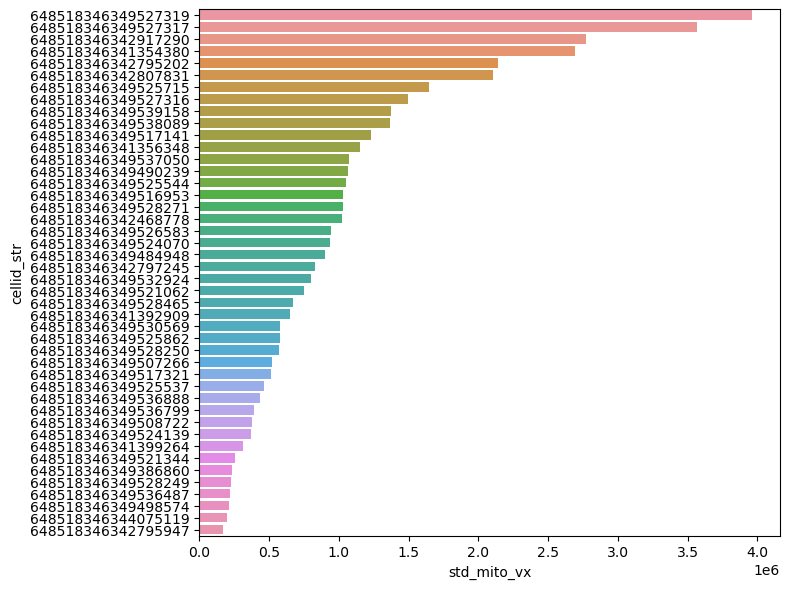

In [80]:
plt.figure(figsize=(8,6))
ax = sns.barplot(std_df_pareto, y='cellid_str', x='std_mito_vx')
#plt.xticks(rotation=90)
plt.tight_layout()
plt.show()

In [81]:
# merge with mito_astrocytes df

mito_astrocytes_std = pd.merge(mito_astrocytes, std_df, on='cellid_str', how='inner')
mito_astrocytes_std

,mito_id,mito_vx,ctr_pos_x_vx,ctr_pos_y_vx,ctr_pos_z_vx,bbox_beg_x_vx,bbox_beg_y_vx,bbox_beg_z_vx,bbox_end_x_vx,bbox_end_y_vx,bbox_end_z_vx,cellid,ctr_pos_x_nm,ctr_pos_y_nm,ctr_pos_z_nm,cellid_str,std_mito_vx
0,3382195,631276,103578,46884,1395,103432,46578,1382,103766,47140,1410,648518346342807831,370809.24,167844.72,55800,648518346342807831,2.104599e+06
1,3259079,540000,101736,40496,1061,101584,40278,1047,101964,40812,1078,648518346342807831,364214.88,144975.68,42440,648518346342807831,2.104599e+06
2,3376366,4726860,104144,44422,1312,102296,43338,1270,105492,45234,1398,648518346342807831,372835.52,159030.76,52480,648518346342807831,2.104599e+06
3,2723586,721876,90620,48158,1091,90230,47834,1080,90996,48450,1110,648518346342807831,324419.60,172405.64,43640,648518346342807831,2.104599e+06
4,2711140,59419932,95316,43668,1090,90366,41518,684,99206,47828,1489,648518346342807831,341231.28,156331.44,43600,648518346342807831,2.104599e+06
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
41838,3547422,553724,104158,73016,307,103938,72756,261,104528,73286,347,648518346344075119,372885.64,261397.28,12280,648518346344075119,2.013843e+05
41839,3553003,575740,105398,73976,821,105148,73844,806,105564,74126,837,648518346344075119,377324.84,264834.08,32840,648518346344075119,2.013843e+05
41840,3333823,600772,100676,74530,641,99826,74426,614,101622,74718,666,648518346344075119,360420.08,266817.40,25640,648518346344075119,2.013843e+05
41841,3443214,905744,103028,74574,569,102744,74262,530,103318,74882,595,648518346344075119,368840.24,266974.92,22760,648518346344075119,2.013843e+05


In [82]:
astro_plot_std = mito_astrocytes_std.sort_values(by='std_mito_vx', ascending=False)
astro_plot_std

,mito_id,mito_vx,ctr_pos_x_vx,ctr_pos_y_vx,ctr_pos_z_vx,bbox_beg_x_vx,bbox_beg_y_vx,bbox_beg_z_vx,bbox_end_x_vx,bbox_end_y_vx,bbox_end_z_vx,cellid,ctr_pos_x_nm,ctr_pos_y_nm,ctr_pos_z_nm,cellid_str,std_mito_vx
35753,1300104,2175716,65306,38682,1498,64892,37918,1468,65836,39558,1536,648518346349527319,233795.48,138481.56,59920,648518346349527319,3.963801e+06
36336,1081382,244880,62466,40254,871,62384,40144,861,62594,40372,883,648518346349527319,223628.28,144109.32,34840,648518346349527319,3.963801e+06
36325,1428143,235696,68642,42394,1199,68494,42264,1188,68752,42552,1216,648518346349527319,245738.36,151770.52,47960,648518346349527319,3.963801e+06
36326,1324424,236356,65734,47806,1883,65626,47736,1874,65832,47890,1892,648518346349527319,235327.72,171145.48,75320,648518346349527319,3.963801e+06
36327,1306536,237312,66438,39842,2103,66334,39758,2092,66568,39942,2114,648518346349527319,237848.04,142634.36,84120,648518346349527319,3.963801e+06
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15379,3623814,191504,106530,57108,427,106472,57040,407,106592,57206,448,648518346342795947,381377.40,204446.64,17080,648518346342795947,1.692047e+05
15378,3862233,7160,111628,62142,56,111596,62110,53,111664,62178,60,648518346342795947,399628.24,222468.36,2240,648518346342795947,1.692047e+05
15377,3751011,7148,109540,62880,520,109508,62852,517,109576,62906,525,648518346342795947,392153.20,225110.40,20800,648518346342795947,1.692047e+05
15376,3628221,7100,106234,57650,321,106204,57630,315,106272,57678,327,648518346342795947,380317.72,206387.00,12840,648518346342795947,1.692047e+05


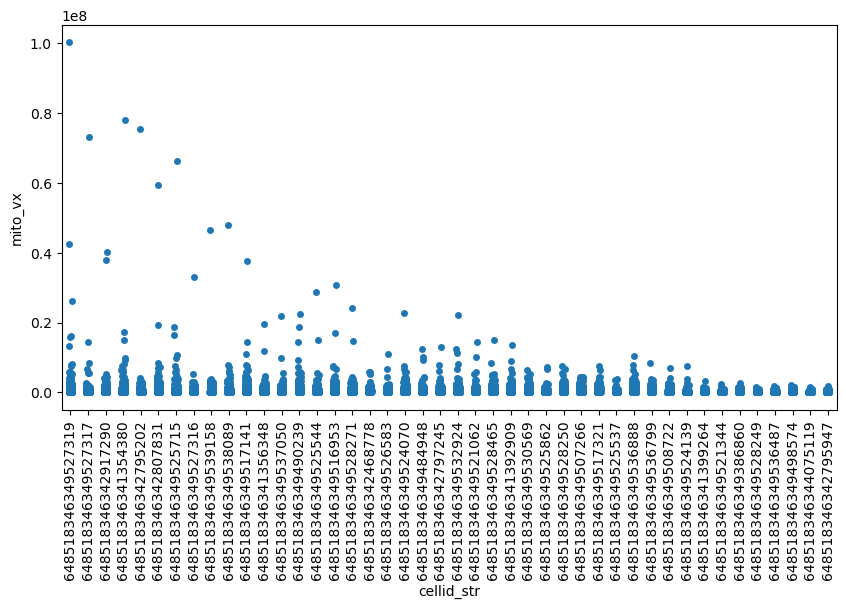

In [83]:
plt.figure(figsize=(10,5))
ax = sns.stripplot(astro_plot_std, x='cellid_str', y='mito_vx')
plt.xticks(rotation=90)
plt.show()

In [84]:
fig = px.strip(astro_plot_std, x="cellid_str", y="mito_vx", hover_data=['mito_id'], log_y=False)
fig.show()

# Skew

In [85]:
# find the skew mito_voxel for each astro

skew_iterator = {}
for i in range(len(astrocyte_list)):
    skew_iterator[str(astrocyte_list[i])] = astro_iterator.get('astro_'+ str(astrocyte_list[i])).mito_vx.skew()
    
locals().update(skew_iterator)

In [86]:
skew_iterator

{'648518346341354380': 24.70944616334014,
 '648518346341356348': 11.178185060831382,
 '648518346341392909': 10.458797250706683,
 '648518346341399264': 5.230167502555706,
 '648518346342468778': 3.5447101494417876,
 '648518346342795202': 34.273245264267025,
 '648518346342795947': 3.7114442448240763,
 '648518346342797245': 9.317147368027705,
 '648518346342807831': 23.33887720578354,
 '648518346342917290': 13.145655588710605,
 '648518346344075119': 3.356178504124836,
 '648518346349386860': 4.012558033369385,
 '648518346349484948': 8.969967775807723,
 '648518346349490239': 12.742719541359193,
 '648518346349498574': 4.331392633503979,
 '648518346349507266': 4.3964784865087125,
 '648518346349508722': 7.024552351883707,
 '648518346349516953': 19.428776471069604,
 '648518346349517141': 20.697310266147248,
 '648518346349517321': 6.046639270152894,
 '648518346349521062': 12.005651566586215,
 '648518346349521344': 4.831633485764702,
 '648518346349524070': 15.364504715282205,
 '648518346349524139':

In [87]:
skew_df = pd.DataFrame.from_dict(skew_iterator, orient='index')
skew_df.reset_index(inplace=True)
skew_df.rename(columns = {'index':'cellid_str', 0:'skew_mito_vx'}, inplace=True)
skew_df_pareto = skew_df.sort_values(by='skew_mito_vx', ascending=False)
skew_df_pareto

,cellid_str,skew_mito_vx
5,648518346342795202,34.273245
26,648518346349525715,31.782582
43,648518346349539158,30.053861
42,648518346349538089,29.446145
0,648518346341354380,24.709446
8,648518346342807831,23.338877
25,648518346349525544,20.999594
18,648518346349517141,20.697310
29,648518346349527316,20.240237
31,648518346349527319,20.195756


In [88]:
skew_df.dtypes

cellid_str       object
skew_mito_vx    float64
dtype: object

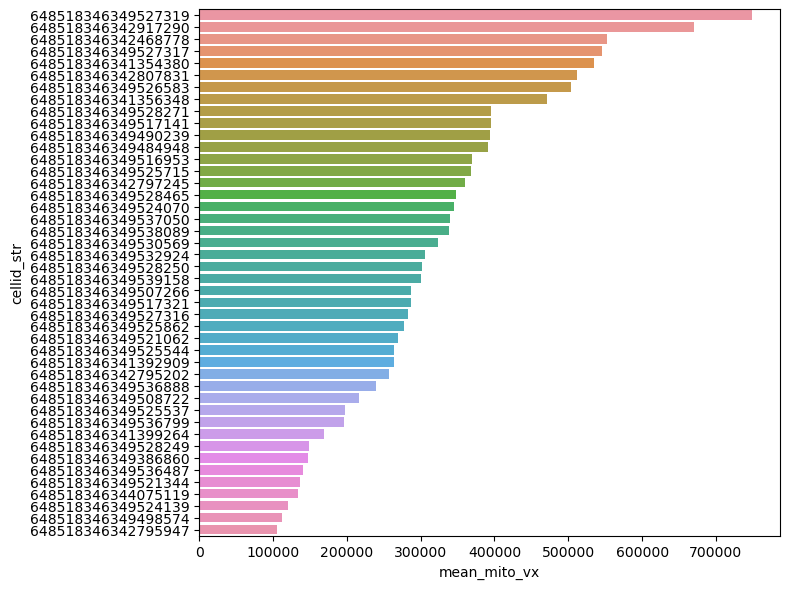

In [89]:
plt.figure(figsize=(8,6))
ax = sns.barplot(mean_df_pareto, y='cellid_str', x='mean_mito_vx')
#plt.xticks(rotation=90)
plt.tight_layout()
plt.show()

In [90]:
# merge with mito_astrocytes df

mito_astrocytes_skew = pd.merge(mito_astrocytes, skew_df, on='cellid_str', how='inner')
mito_astrocytes_skew

,mito_id,mito_vx,ctr_pos_x_vx,ctr_pos_y_vx,ctr_pos_z_vx,bbox_beg_x_vx,bbox_beg_y_vx,bbox_beg_z_vx,bbox_end_x_vx,bbox_end_y_vx,bbox_end_z_vx,cellid,ctr_pos_x_nm,ctr_pos_y_nm,ctr_pos_z_nm,cellid_str,skew_mito_vx
0,3382195,631276,103578,46884,1395,103432,46578,1382,103766,47140,1410,648518346342807831,370809.24,167844.72,55800,648518346342807831,23.338877
1,3259079,540000,101736,40496,1061,101584,40278,1047,101964,40812,1078,648518346342807831,364214.88,144975.68,42440,648518346342807831,23.338877
2,3376366,4726860,104144,44422,1312,102296,43338,1270,105492,45234,1398,648518346342807831,372835.52,159030.76,52480,648518346342807831,23.338877
3,2723586,721876,90620,48158,1091,90230,47834,1080,90996,48450,1110,648518346342807831,324419.60,172405.64,43640,648518346342807831,23.338877
4,2711140,59419932,95316,43668,1090,90366,41518,684,99206,47828,1489,648518346342807831,341231.28,156331.44,43600,648518346342807831,23.338877
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
41838,3547422,553724,104158,73016,307,103938,72756,261,104528,73286,347,648518346344075119,372885.64,261397.28,12280,648518346344075119,3.356179
41839,3553003,575740,105398,73976,821,105148,73844,806,105564,74126,837,648518346344075119,377324.84,264834.08,32840,648518346344075119,3.356179
41840,3333823,600772,100676,74530,641,99826,74426,614,101622,74718,666,648518346344075119,360420.08,266817.40,25640,648518346344075119,3.356179
41841,3443214,905744,103028,74574,569,102744,74262,530,103318,74882,595,648518346344075119,368840.24,266974.92,22760,648518346344075119,3.356179


In [91]:
astro_plot_skew = mito_astrocytes_skew.sort_values(by='skew_mito_vx', ascending=False)
astro_plot_skew

,mito_id,mito_vx,ctr_pos_x_vx,ctr_pos_y_vx,ctr_pos_z_vx,bbox_beg_x_vx,bbox_beg_y_vx,bbox_beg_z_vx,bbox_end_x_vx,bbox_end_y_vx,bbox_end_z_vx,cellid,ctr_pos_x_nm,ctr_pos_y_nm,ctr_pos_z_nm,cellid_str,skew_mito_vx
29983,4226660,329856,117752,67658,2008,117606,67518,1992,117954,67820,2024,648518346342795202,421552.16,242215.64,80320,648518346342795202,34.273245
29245,4225577,14592,116712,68338,1586,116660,68306,1583,116792,68378,1590,648518346342795202,417828.96,244650.04,63440,648518346342795202,34.273245
29238,4215376,14168,116650,65264,2077,116606,65228,2073,116692,65310,2081,648518346342795202,417607.00,233645.12,83080,648518346342795202,34.273245
29239,4113857,14220,115412,71366,1665,115356,71320,1663,115452,71416,1669,648518346342795202,413174.96,255490.28,66600,648518346342795202,34.273245
29240,4123705,14284,115870,74742,2009,115834,74704,2005,115928,74796,2014,648518346342795202,414814.60,267576.36,80360,648518346342795202,34.273245
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
39382,582782,53508,51546,61844,302,51474,61756,295,51620,61906,319,648518346349528249,184534.68,221401.52,12080,648518346349528249,3.021415
39381,480450,53272,50346,61440,395,50288,61404,387,50400,61476,403,648518346349528249,180238.68,219955.20,15800,648518346349528249,3.021415
39380,576618,52564,50642,61026,371,50596,60858,363,50692,61136,379,648518346349528249,181298.36,218473.08,14840,648518346349528249,3.021415
39379,684357,50656,52962,60248,371,52898,60196,366,53016,60288,377,648518346349528249,189603.96,215687.84,14840,648518346349528249,3.021415


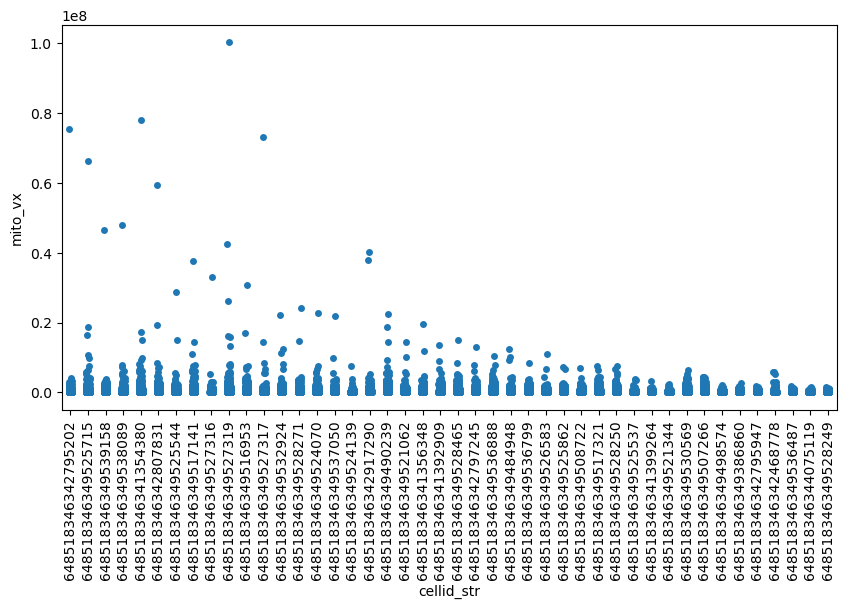

In [92]:
plt.figure(figsize=(10,5))
ax = sns.stripplot(astro_plot_skew, x='cellid_str', y='mito_vx')
plt.xticks(rotation=90)
plt.show()

In [93]:
fig = px.strip(astro_plot_skew, x="cellid_str", y="mito_vx", hover_data=['mito_id'])
fig.show()

Astrocyte 648518346349536487
- An astrocyte at the edge of the volume; however, it also appears to have a truncated edge within the volume (this should not be the case)

# Neuroglancer viewer using a filter for mito voxels

In [94]:
mito_astrocytes.sort_values(by='mito_vx', ascending=False)

,mito_id,mito_vx,ctr_pos_x_vx,ctr_pos_y_vx,ctr_pos_z_vx,bbox_beg_x_vx,bbox_beg_y_vx,bbox_beg_z_vx,bbox_end_x_vx,bbox_end_y_vx,bbox_end_z_vx,cellid,ctr_pos_x_nm,ctr_pos_y_nm,ctr_pos_z_nm,cellid_str
8141,866030,100327168,64014,42198,1606,56972,36422,1335,69342,47894,2063,648518346349527319,229170.12,151068.84,64240,648518346349527319
4186,2526416,78158580,93642,61286,1787,86768,54870,1484,99966,66696,2043,648518346341354380,335238.36,219403.88,71480,648518346341354380
13684,3882596,75583848,115002,73240,1792,110136,69844,1469,119224,76370,2157,648518346342795202,411707.16,262199.20,71680,648518346342795202
1392,1607426,73260720,74412,73488,1986,69838,70410,1657,80624,76226,2157,648518346349527317,266394.96,263087.04,79440,648518346349527317
985,1461550,66313908,73106,58042,1919,67040,54926,1527,76878,64996,2157,648518346349525715,261719.48,207790.36,76760,648518346349525715
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
79351,2731387,1200,91322,50126,1838,91312,50110,1837,91344,50146,1841,648518346349490239,326932.76,179451.08,73520,648518346349490239
79373,1850070,1200,73906,73780,1060,73884,73770,1059,73932,73794,1062,648518346349508722,264583.48,264132.40,42400,648518346349508722
79392,819047,1200,56490,71016,940,56472,71000,939,56514,71038,943,648518346349521344,202234.20,254237.28,37600,648518346349521344
79393,3856586,1200,110124,60062,222,110112,60032,221,110136,60086,225,648518346342795947,394243.92,215021.96,8880,648518346342795947


In [95]:
threshold = 30000000
mito_filter = mito_astrocytes[mito_astrocytes['mito_vx'] > threshold]
mito_filter.cellid.unique()

array([648518346349525715, 648518346349527319, 648518346349527317,
       648518346342807831, 648518346342917290, 648518346349517141,
       648518346349516953, 648518346349539158, 648518346341354380,
       648518346349538089, 648518346342795202, 648518346349527316],
      dtype=int64)

In [96]:
indx = 0
lookup = mito_filter.cellid.unique()[indx]

In [97]:
print(mito_filter.cellid.unique()[indx])

648518346349525715


In [98]:
mitoquery = mito[mito["cellid"] == lookup]

In [99]:
len(mitoquery)

2133

In [100]:
mitoquery

,mito_id,mito_vx,ctr_pos_x_vx,ctr_pos_y_vx,ctr_pos_z_vx,bbox_beg_x_vx,bbox_beg_y_vx,bbox_beg_z_vx,bbox_end_x_vx,bbox_end_y_vx,bbox_end_z_vx,cellid,ctr_pos_x_nm,ctr_pos_y_nm,ctr_pos_z_nm,cellid_str
507,1704695,3846692,73678,62978,1111,71600,62378,1054,75502,63726,1195,648518346349525715,263767.24,225461.24,44440,648518346349525715
533,1824866,610832,74532,63232,2055,74114,62806,2026,75090,63714,2109,648518346349525715,266824.56,226370.56,82200,648518346349525715
747,1681648,595604,73046,52752,1739,72914,52360,1716,73182,53104,1769,648518346349525715,261504.68,188852.16,69560,648518346349525715
985,1461550,66313908,73106,58042,1919,67040,54926,1527,76878,64996,2157,648518346349525715,261719.48,207790.36,76760,648518346349525715
1137,1675597,2530692,72678,51294,1622,72028,50456,1560,73222,52196,1712,648518346349525715,260187.24,183632.52,64880,648518346349525715
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2409333,1462277,1485076,68150,58404,1940,67674,58060,1898,68610,58944,2009,648518346349525715,243977.00,209086.32,77600,648518346349525715
2409340,1689059,1501176,71624,56258,2030,71078,55794,1990,72274,56656,2087,648518346349525715,256413.92,201403.64,81200,648518346349525715
2409372,2168686,1547648,79794,59712,838,79588,59436,785,80092,60070,874,648518346349525715,285662.52,213768.96,33520,648518346349525715
2409428,1800878,3521108,74046,52986,1683,73726,51886,1540,74400,53884,1814,648518346349525715,265084.68,189689.88,67320,648518346349525715


In [107]:
mitoquery_list = mitoquery["mito_id"].to_list()

spacer = "%22%2C%22"

# Source: https://www.simplilearn.com/tutorials/python-tutorial/list-to-string-in-python
mitoquery_list_join = spacer.join(map(str,mitoquery_list))

baseURL = 'https://neuromancer-seung-import.appspot.com/'
nglink_a = '#!%7B%22layers%22:%5B%7B%22source%22:%22precomputed://gs://microns_public_datasets/pinky100_v0/son_of_alignment_v15_rechunked%22%2C%22type%22:%22image%22%2C%22blend%22:%22default%22%2C%22shaderControls%22:%7B%7D%2C%22name%22:%22EM%22%7D%2C%7B%22source%22:%22precomputed://gs://microns_public_datasets/pinky100_v185/seg%22%2C%22type%22:%22segmentation%22%2C%22selectedAlpha%22:0.51%2C%22objectAlpha%22:0.15%2C%22segments%22:%5B%22'
nglink_b = '%22%5D%2C%22skeletonRendering%22:%7B%22mode2d%22:%22lines_and_points%22%2C%22mode3d%22:%22lines%22%7D%2C%22name%22:%22cell_segmentation_v185%22%7D%2C%7B%22source%22:%22precomputed://https://td.princeton.edu/sseung-archive/pinky100-clefts/mip1_d2_1175k%22%2C%22type%22:%22segmentation%22%2C%22skeletonRendering%22:%7B%22mode2d%22:%22lines_and_points%22%2C%22mode3d%22:%22lines%22%7D%2C%22name%22:%22synapses%22%7D%2C%7B%22source%22:%22precomputed://https://td.princeton.edu/sseung-archive/pinky100-mito/seg_191220%22%2C%22type%22:%22segmentation%22%2C%22segments%22:%5B%22'
nglink_c = '%22%5D%2C%22skeletonRendering%22:%7B%22mode2d%22:%22lines_and_points%22%2C%22mode3d%22:%22lines%22%7D%2C%22name%22:%22mitochondria%22%7D%2C%7B%22source%22:%22precomputed://https://td.princeton.edu/sseung-archive/pinky100-nuclei/seg%22%2C%22type%22:%22segmentation%22%2C%22skeletonRendering%22:%7B%22mode2d%22:%22lines_and_points%22%2C%22mode3d%22:%22lines%22%7D%2C%22name%22:%22nuclei%22%7D%5D%2C%22navigation%22:%7B%22pose%22:%7B%22position%22:%7B%22voxelSize%22:%5B4%2C4%2C40%5D%2C%22voxelCoordinates%22:%5B83222.921875%2C52981.34765625%2C824.9962768554688%5D%7D%7D%2C%22zoomFactor%22:383.0066650796121%7D%2C%22perspectiveOrientation%22:%5B-0.00825042650103569%2C0.06130112707614899%2C-0.0012821174459531903%2C0.9980843663215637%5D%2C%22perspectiveZoom%22:3618.7659948513424%2C%22showSlices%22:false%2C%22selectedLayer%22:%7B%22layer%22:%22mitochondria%22%2C%22visible%22:true%7D%2C%22layout%22:%7B%22type%22:%223d%22%2C%22orthographicProjection%22:true%7D%7D'
neuroglancerURL = baseURL + nglink_a + str(lookup) + nglink_b + mitoquery_list_join + nglink_c

In [108]:
print(neuroglancerURL)

https://neuromancer-seung-import.appspot.com/#!%7B%22layers%22:%5B%7B%22source%22:%22precomputed://gs://microns_public_datasets/pinky100_v0/son_of_alignment_v15_rechunked%22%2C%22type%22:%22image%22%2C%22blend%22:%22default%22%2C%22shaderControls%22:%7B%7D%2C%22name%22:%22EM%22%7D%2C%7B%22source%22:%22precomputed://gs://microns_public_datasets/pinky100_v185/seg%22%2C%22type%22:%22segmentation%22%2C%22selectedAlpha%22:0.51%2C%22objectAlpha%22:0.15%2C%22segments%22:%5B%22648518346349525715%22%5D%2C%22skeletonRendering%22:%7B%22mode2d%22:%22lines_and_points%22%2C%22mode3d%22:%22lines%22%7D%2C%22name%22:%22cell_segmentation_v185%22%7D%2C%7B%22source%22:%22precomputed://https://td.princeton.edu/sseung-archive/pinky100-clefts/mip1_d2_1175k%22%2C%22type%22:%22segmentation%22%2C%22skeletonRendering%22:%7B%22mode2d%22:%22lines_and_points%22%2C%22mode3d%22:%22lines%22%7D%2C%22name%22:%22synapses%22%7D%2C%7B%22source%22:%22precomputed://https://td.princeton.edu/sseung-archive/pinky100-mito/seg_19